# **Detección de anomalías en los patrones de comportamiento de los clientes no regulados en la filial Electro Dunas del Grupo Energía Bogotá**

Este Notebook, hace parte del trabajo de grado de la maestría en inteligencia analítica de datos de la Universidad de los Andes en él se realizan la verificación de supuestos, búsqueda de los mejores hiperparametros y evalución de desempeño en la clasificación por parte de los modelos.

Realizado por: Miller Puentes, Grace González, Camilo, Robayo, Joan Chacón.

In [59]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.tsa.seasonal import seasonal_decompose
import matplotlib.pyplot as plt
from sklearn.neighbors import LocalOutlierFactor
from ipywidgets import widgets, interact
import plotly.express as px
from datetime import datetime
from sklearn.ensemble import IsolationForest
import os
import warnings

from sklearn.ensemble import IsolationForest
from sklearn.covariance import EllipticEnvelope
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from scipy.stats import shapiro, normaltest, anderson
from scipy.stats import shapiro, normaltest, anderson, boxcox
from scipy.special import boxcox1p

warnings.filterwarnings('ignore')


In [60]:
# Para colocar el enlace al Drive
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [61]:
# Lista todos los archivos csv en la carpeta de gerencia

# folder_path = '/content/drive/My Drive/MIAD/gerencia/'
folder_path = '/content/drive/My Drive/MIAD_Gerencia de proyectos/4_Guía/Data'
files = [f for f in os.listdir(folder_path) if f.endswith('.csv')]

# Crea un DataFrame vacío para almacenar todos los datos
all_data = pd.DataFrame()

# Itera sobre los archivos y los concatena en el DataFrame all_data
for file in files:
    file_path = os.path.join(folder_path, file)
    data = pd.read_csv(file_path)

    # Extrae el número de cliente del nombre del archivo (suponiendo que es el número que viene después de 'CLIENTE' y antes del '.csv')
    cliente_id = int(file.replace('DATOSCLIENTE', '').replace('.csv', ''))

    # Agrega la columna cliente_id al DataFrame
    data['Cliente_ID'] = cliente_id

    all_data = pd.concat([all_data, data], ignore_index=True)



# Asegúrate de cambiar el nombre del archivo y la ruta si es necesario
# file_path = '/content/drive/My Drive/MIAD/gerencia/sector_economico_clientes.xlsx'
file_path = '/content/drive/My Drive/MIAD_Gerencia de proyectos/4_Guía/Data/sector_economico_clientes.xlsx'
sector_economico_clientes = pd.read_excel(file_path)

# Muestra las primeras filas del dataframe


sector_economico_clientes['Cliente_ID'] = (
    sector_economico_clientes['Cliente:']
    .str.extract('(\d+)')  # Extrae el número del nombre del cliente
    .astype(int)           # Convierte el resultado en entero
)

data_merged = pd.merge(all_data, sector_economico_clientes, on='Cliente_ID', how='left')

# Muestra las primeras filas del dataframe combinado
data_merged.head()

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...
3,2021-01-01 03:00:00,0.566425,0.495791,452.329255,444.122989,1,Cliente 1,Elaboración de cacao y chocolate y de producto...
4,2021-01-01 04:00:00,1.080556,0.472018,513.477596,535.463719,1,Cliente 1,Elaboración de cacao y chocolate y de producto...


In [62]:
data_filtered_neg = data_merged[data_merged['Active_energy'] >= 0]
print(data_merged.shape)
print(data_filtered_neg.shape)


data_filtered_neg_sorted=data_filtered_neg.sort_values(by=['Cliente_ID', 'Fecha'])

data_filtered_neg_sorted['Fecha'] = pd.to_datetime(data_filtered_neg_sorted['Fecha'])

# Asegurarse de que solo se incluyan las fechas deseadas
data_filtered_neg_sorted = data_filtered_neg_sorted[(data_filtered_neg_sorted['Fecha'].dt.year >= 2020) & (data_filtered_neg_sorted['Fecha'].dt.year <= 2024)]
print(data_filtered_neg_sorted.shape)

(351020, 8)
(350515, 8)
(350515, 8)


# Revisión de Normalidad

Comprobando la normalidad de la EA para cada cliente

In [63]:
# Obtener una lista única de clientes
clientes = data_filtered_neg_sorted['Cliente_ID'].unique()

# Diccionario para almacenar resultados
resultados_normalidad = {}

for cliente in clientes:
    # Filtrar los datos por cliente
    data_cliente = data_filtered_neg_sorted[data_filtered_neg_sorted['Cliente_ID'] == cliente]['Active_energy']

    # Si hay suficientes datos, realizar las pruebas
    if len(data_cliente) > 20:  # Asegurar un mínimo de datos para la confiabilidad de las pruebas
        # Aplicar la prueba de Shapiro-Wilk
        shapiro_stat, shapiro_p = shapiro(data_cliente)

        # Aplicar la prueba de D'Agostino's K^2
        dago_stat, dago_p = normaltest(data_cliente)

        # Aplicar la prueba de Anderson-Darling
        ad_test = anderson(data_cliente)
        ad_stat = ad_test.statistic
        ad_crit = ad_test.critical_values
        ad_sig = ad_test.significance_level

        # Guardar los resultados en el diccionario
        resultados_normalidad[cliente] = {
            'Shapiro-Wilk': {'Estadístico': shapiro_stat, 'P-valor': shapiro_p},
            'D\'Agostino\'s K^2': {'Estadístico': dago_stat, 'P-valor': dago_p},
            'Anderson-Darling': {'Estadístico': ad_stat, 'Valores críticos': ad_crit, 'Niveles de significancia': ad_sig}
        }

# Imprimir los resultados
for cliente, resultados in resultados_normalidad.items():
    print(f"Cliente: {cliente}")
    for test, valores in resultados.items():
        print(f"{test}: {valores}")
    print()  # Espacio entre clientes para mejor legibilidad


Cliente: 1
Shapiro-Wilk: {'Estadístico': 0.7821241617202759, 'P-valor': 0.0}
D'Agostino's K^2: {'Estadístico': 5149.624181022981, 'P-valor': 0.0}
Anderson-Darling: {'Estadístico': 1711.1137508412066, 'Valores críticos': array([0.576, 0.656, 0.787, 0.918, 1.092]), 'Niveles de significancia': array([15. , 10. ,  5. ,  2.5,  1. ])}

Cliente: 3
Shapiro-Wilk: {'Estadístico': 0.7601168155670166, 'P-valor': 0.0}
D'Agostino's K^2: {'Estadístico': 7529.335606266761, 'P-valor': 0.0}
Anderson-Darling: {'Estadístico': 1734.77128701517, 'Valores críticos': array([0.576, 0.656, 0.787, 0.918, 1.092]), 'Niveles de significancia': array([15. , 10. ,  5. ,  2.5,  1. ])}

Cliente: 4
Shapiro-Wilk: {'Estadístico': 0.6363703012466431, 'P-valor': 0.0}
D'Agostino's K^2: {'Estadístico': 9261.80096464587, 'P-valor': 0.0}
Anderson-Darling: {'Estadístico': 2799.474208732099, 'Valores críticos': array([0.576, 0.656, 0.787, 0.918, 1.092]), 'Niveles de significancia': array([15. , 10. ,  5. ,  2.5,  1. ])}

Cliente:

Realizando transformaciones para verificar si se cumple el supuesto de Normalidad:

In [64]:
# Asumiendo que `data_filtered_neg_sorted` es tu DataFrame y ya está importado

# Obtener una lista única de clientes
clientes = data_filtered_neg_sorted['Cliente_ID'].unique()

# Diccionario para almacenar resultados
resultados_normalidad = {}

for cliente in clientes:
    # Filtrar los datos por cliente
    data_cliente = data_filtered_neg_sorted[data_filtered_neg_sorted['Cliente_ID'] == cliente]['Active_energy']

    # Si hay suficientes datos, realizar las pruebas
    if len(data_cliente) > 20:  # Asegurar un mínimo de datos para la confiabilidad de las pruebas
        # Realizar transformaciones
        data_log = np.log(data_cliente[data_cliente > 0])  # Logarítmica, solo para valores positivos
        data_boxcox, _ = boxcox(data_cliente[data_cliente > 0] + 1)  # Box-Cox, ajuste para incluir ceros

        # Lista de datos transformados
        transformations = {'Original': data_cliente, 'Logarithmic': data_log, 'Box-Cox': data_boxcox}

        for name, data in transformations.items():
            # Aplicar la prueba de Shapiro-Wilk
            shapiro_stat, shapiro_p = shapiro(data)

            # Aplicar la prueba de D'Agostino's K^2
            dago_stat, dago_p = normaltest(data)

            # Aplicar la prueba de Anderson-Darling
            ad_test = anderson(data)
            ad_stat = ad_test.statistic
            ad_crit = ad_test.critical_values
            ad_sig = ad_test.significance_level

            # Guardar los resultados en el diccionario
            if cliente not in resultados_normalidad:
                resultados_normalidad[cliente] = {}
            resultados_normalidad[cliente][name] = {
                'Shapiro-Wilk': {'Estadístico': shapiro_stat, 'P-valor': shapiro_p},
                'D\'Agostino\'s K^2': {'Estadístico': dago_stat, 'P-valor': dago_p},
                'Anderson-Darling': {'Estadístico': ad_stat, 'Valores críticos': ad_crit, 'Niveles de significancia': ad_sig}
            }

# Imprimir los resultados
for cliente, transformaciones in resultados_normalidad.items():
    print(f"Cliente: {cliente}")
    for transformacion, resultados in transformaciones.items():
        print(f"Transformación: {transformacion}")
        for test, valores in resultados.items():
            print(f"  {test}: {valores}")
    print()  # Espacio entre clientes para mejor legibilidad

Cliente: 1
Transformación: Original
  Shapiro-Wilk: {'Estadístico': 0.7821241617202759, 'P-valor': 0.0}
  D'Agostino's K^2: {'Estadístico': 5149.624181022981, 'P-valor': 0.0}
  Anderson-Darling: {'Estadístico': 1711.1137508412066, 'Valores críticos': array([0.576, 0.656, 0.787, 0.918, 1.092]), 'Niveles de significancia': array([15. , 10. ,  5. ,  2.5,  1. ])}
Transformación: Logarithmic
  Shapiro-Wilk: {'Estadístico': 0.8757545351982117, 'P-valor': 0.0}
  D'Agostino's K^2: {'Estadístico': 5876.342413839082, 'P-valor': 0.0}
  Anderson-Darling: {'Estadístico': 729.1419310306337, 'Valores críticos': array([0.576, 0.656, 0.787, 0.918, 1.092]), 'Niveles de significancia': array([15. , 10. ,  5. ,  2.5,  1. ])}
Transformación: Box-Cox
  Shapiro-Wilk: {'Estadístico': 0.9394122958183289, 'P-valor': 0.0}
  D'Agostino's K^2: {'Estadístico': 101.96706530780168, 'P-valor': 7.213285145917677e-23}
  Anderson-Darling: {'Estadístico': 522.6301809980687, 'Valores críticos': array([0.576, 0.656, 0.787, 

# Anomalías Energía Reactiva (ER)/ Energía Activa (EA)

Este tipo de Anomalías es importante porque dependiendo de la Energía Reactiva consumida con respecto a la Energía Activa en un mismo més se puede generar sobre cargos para el cliente por incumplimiento de la clusula 10.4:

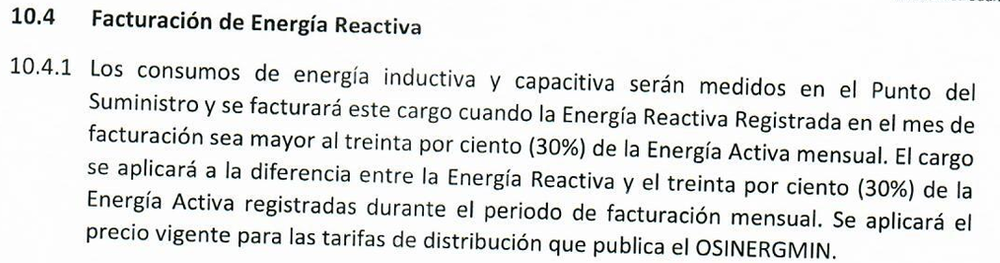

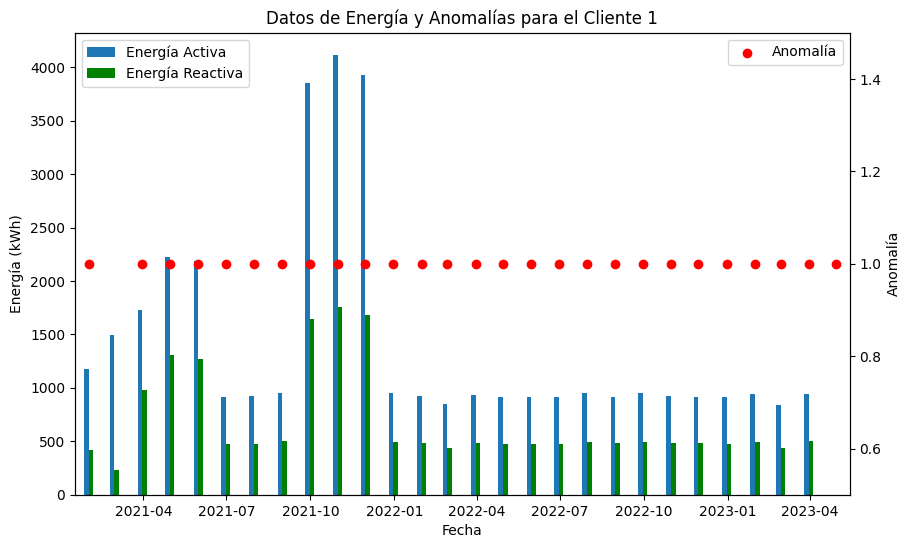

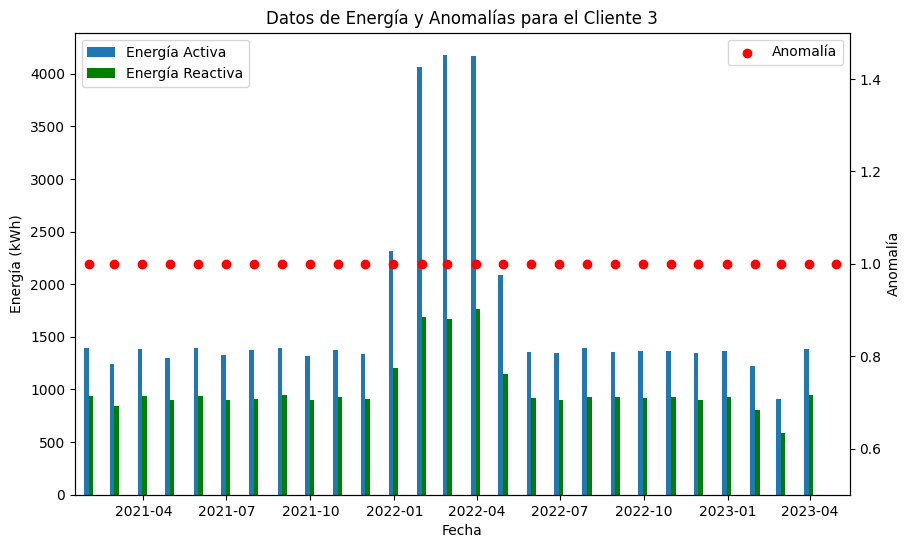

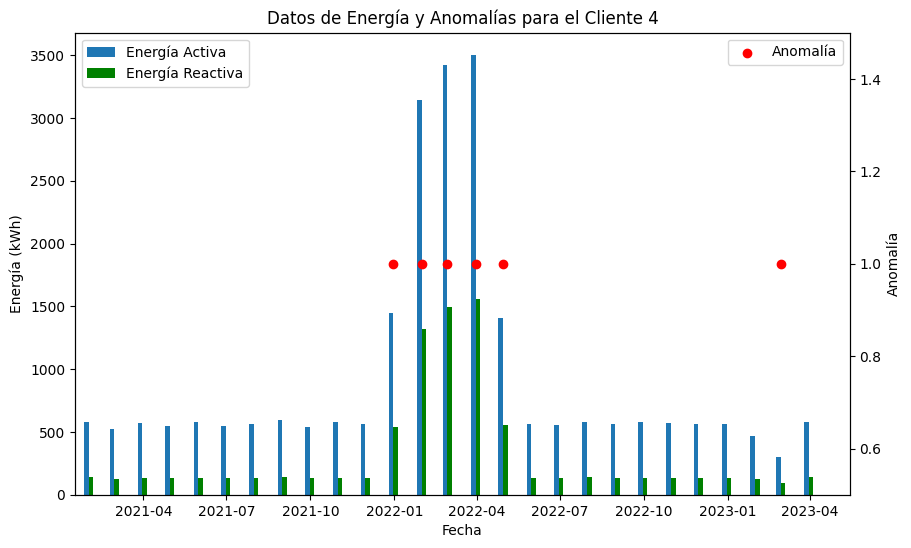

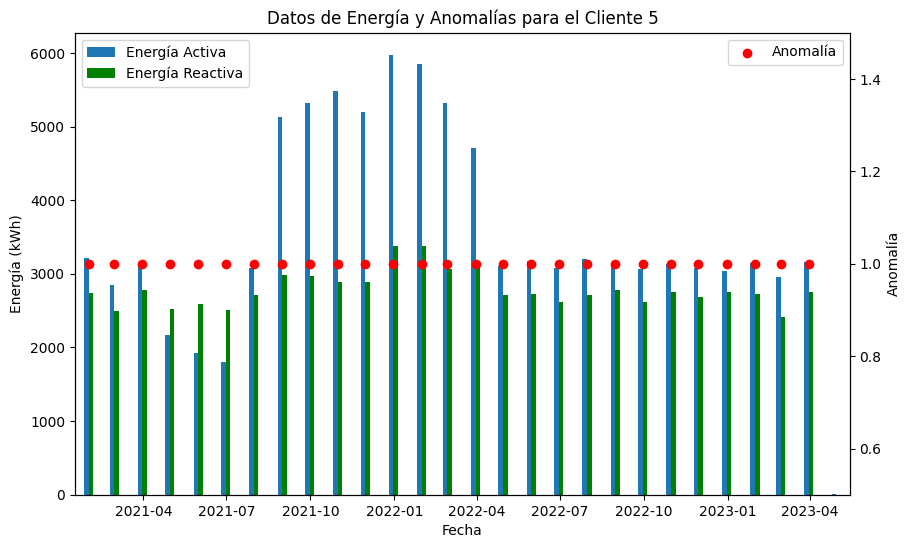

...

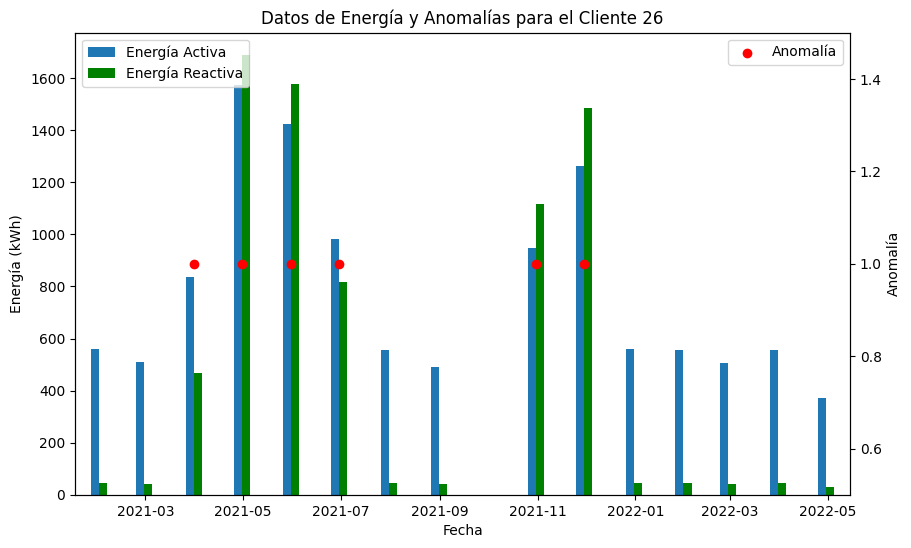

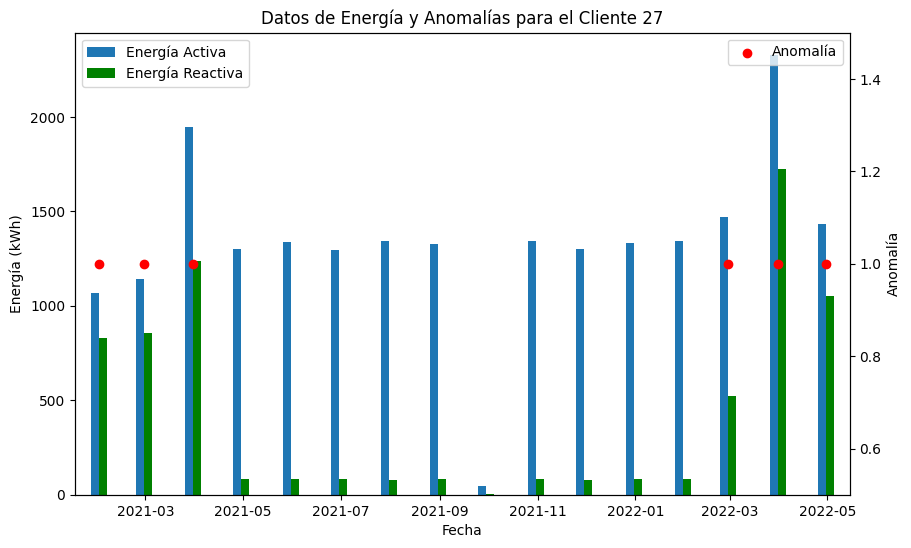

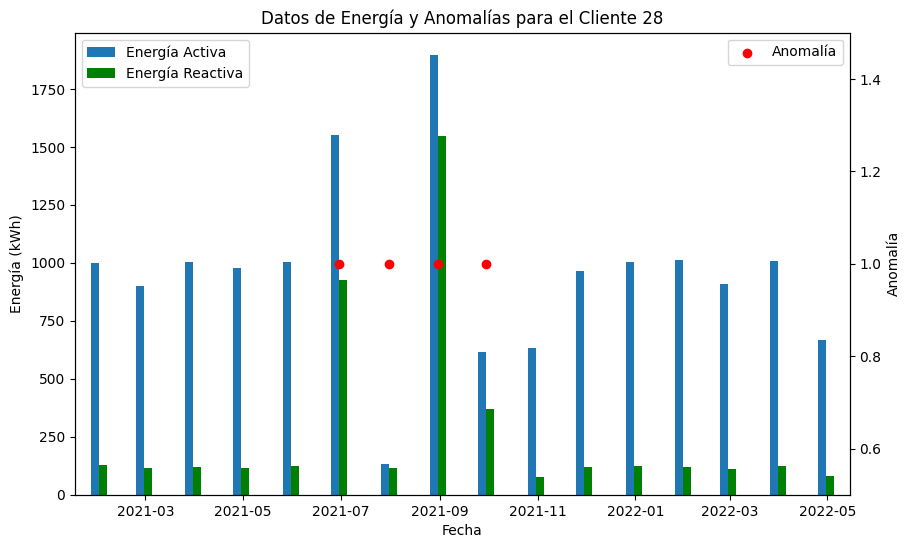

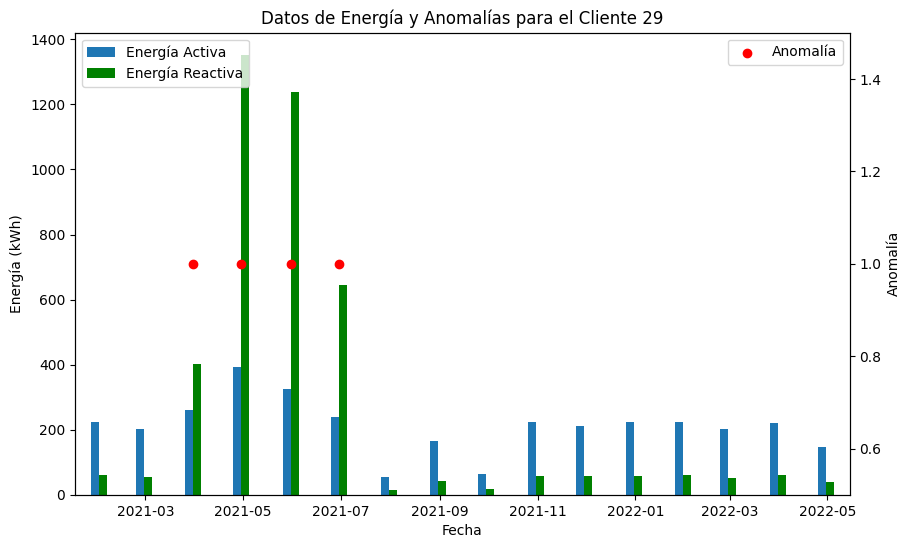

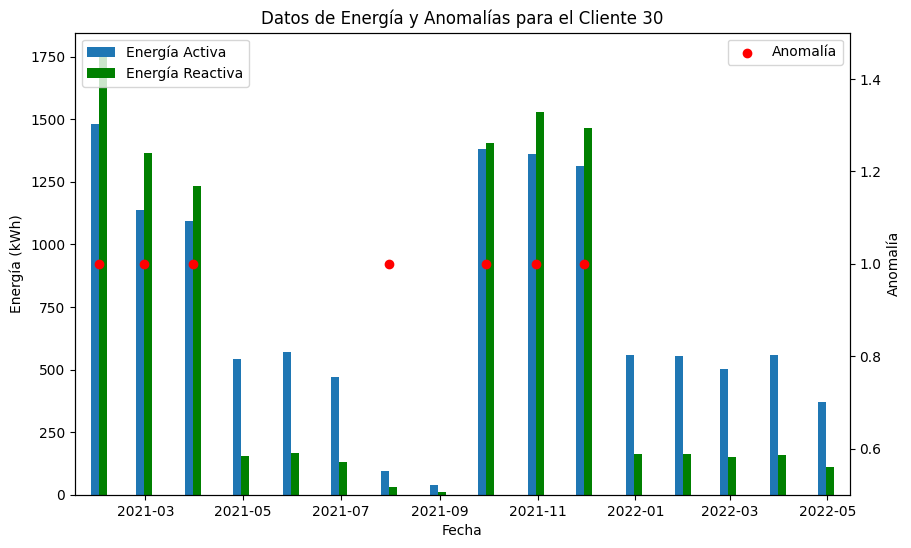

,Fecha,Active_energy,Reactive_energy,Cliente_ID,Reactive_to_Active_ratio,Anomalía
0,2021-01-31,1179.028493,415.713658,1,35.259000,1
1,2021-02-28,1490.128945,231.737781,1,15.551525,0
2,2021-03-31,1728.240344,978.845693,1,56.638285,1
3,2021-04-30,2228.447578,1304.500199,1,58.538519,1
4,2021-05-31,2190.919624,1269.936238,1,57.963616,1
...,...,...,...,...,...,...
491,2021-12-31,557.623290,162.509190,30,29.143186,0
492,2022-01-31,555.454032,164.041544,30,29.532875,0
493,2022-02-28,502.660360,149.013247,30,29.644917,0
494,2022-03-31,556.726413,160.706109,30,28.866263,0


In [65]:
def generar_grafica_y_df_para_cliente(data_filtered_neg, num_cliente):
    # Filtrar el DataFrame por el número de cliente
    df = data_filtered_neg[data_filtered_neg['Cliente_ID'] == num_cliente]

    # Seleccionar las columnas 'Fecha', 'Active_energy' y 'Reactive_energy'
    df = df[['Fecha', 'Active_energy', 'Reactive_energy']]

    # Convertir la columna 'Fecha' a tipo datetime y establecer como índice del DataFrame
    df['Fecha'] = pd.to_datetime(df['Fecha'])
    df.set_index('Fecha', inplace=True)

    # Sumar el consumo de energía activa y reactiva por mes
    df_resumen = df.resample('M').sum()

    # Agregar el ID del cliente y calcular el porcentaje de energía reactiva sobre energía activa
    df_resumen['Cliente_ID'] = num_cliente
    df_resumen['Reactive_to_Active_ratio'] = (df_resumen['Reactive_energy'] / df_resumen['Active_energy']) * 100

    # Crear y establecer la columna 'Anomalía' según el criterio especificado
    df_resumen['Anomalía'] = 0
    df_resumen.loc[df_resumen['Reactive_to_Active_ratio'] > 30, 'Anomalía'] = 1
    df_resumen.reset_index(inplace=True)

    # Crear una figura y un eje
    fig, ax1 = plt.subplots(figsize=(10, 6))

    # Gráfico de barras para energía activa y reactiva
    bar_width = 5  # Ancho de las barras
    ax1.bar(df_resumen['Fecha'] - pd.Timedelta(days=bar_width/2), df_resumen['Active_energy'], color='tab:blue', width=bar_width, label='Energía Activa')
    ax1.bar(df_resumen['Fecha'] + pd.Timedelta(days=bar_width/2), df_resumen['Reactive_energy'], color='g', width=bar_width, label='Energía Reactiva')
    ax1.set_xlabel('Fecha')
    ax1.set_ylabel('Energía (kWh)')
    ax1.legend(loc='upper left')
    ax1.autoscale(enable=True, axis='both', tight=False)
    ax1.set_xlim([df_resumen['Fecha'].min() - pd.Timedelta(days=15), df_resumen['Fecha'].max() + pd.Timedelta(days=15)])

    # Filtrar solo las filas donde Anomalía es 1
    df_anomalias = df_resumen[df_resumen['Anomalía'] == 1]

    # Crear un segundo eje para las anomalías
    ax2 = ax1.twinx()
    ax2.scatter(df_anomalias['Fecha'], df_anomalias['Anomalía'], color='r', marker='o', label='Anomalía')
    ax2.set_ylabel('Anomalía')
    ax2.legend(loc='upper right')
    ax2.set_ylim([0.5, 1.5])

    # Mostrar la gráfica
    plt.title(f'Datos de Energía y Anomalías para el Cliente {num_cliente}')
    plt.show()

    print("")

    return df_resumen

def evaluar_todos_los_clientes(data_filtered_neg):
    resultados = []
    clientes_unicos = data_filtered_neg['Cliente_ID'].unique()

    for num_cliente in clientes_unicos:
        resultado_cliente = generar_grafica_y_df_para_cliente(data_filtered_neg, num_cliente)
        resultados.append(resultado_cliente)

    df_resultados = pd.concat(resultados, ignore_index=True)

    return df_resultados


df_resultados_todos_los_clientes = evaluar_todos_los_clientes(data_filtered_neg_sorted)
df_resultados_todos_los_clientes

# Proceso para data con granularidad original: Por hora

Asumiendo que todo lo que es superior a 2.25 desviaciones estándar es una anomalía:

In [ ]:
def detect_anomalies(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    # Mediana y desviación estandar
    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    # z Scores
    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Anomalía'] = ((client_data['Z_Score'] > 2.25) | (client_data['Z_Score'] < -2.25)).astype(int)

    return client_data

all_z_results = []

for client_id in data_filtered_neg_sorted['Cliente_ID'].unique():
    z_results = detect_anomalies(client_id, data_filtered_neg_sorted)
    all_z_results.append(z_results)

df_anomalias = pd.concat(all_z_results)
df_anomalias.head(3)

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:,Z_Score,Anomalía
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.784317,0
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.774365,0
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.310384,0


In [ ]:
def calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas):
    matrices_confusion = {}

    for columna_prediccion, nombre_columna in zip(columnas_prediccion, nombres_columnas):
        matriz_confusion = confusion_matrix(y_true, columna_prediccion)
        matrices_confusion[nombre_columna] = matriz_confusion

    return matrices_confusion

def calcular_metricas(matriz_confusion):
    tn, fp, fn, tp = matriz_confusion.ravel()

    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp) if tp + fp > 0 else 0
    recall = tp / (tp + fn) if tp + fn > 0 else 0
    specificity = tn / (tn + fp) if tn + fp > 0 else 0
    f1_score = 2 * precision * recall / (precision + recall) if precision + recall > 0 else 0

    return accuracy, precision, recall, specificity, f1_score

def imprimir_matrices_confusion(matrices_confusion, nombres_columnas):
    max_nombre_length = max(len(nombre) for nombre in nombres_columnas)
    nombre_format = "{:<{}}".format("Nombre", max_nombre_length)

    print(nombre_format, " |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score")
    print("-" * (max_nombre_length + 73))

    for nombre_columna in nombres_columnas:
        matriz = matrices_confusion[nombre_columna]
        tn, fp, fn, tp = matriz.ravel()
        accuracy, precision, recall, specificity, f1_score = calcular_metricas(matriz)
        print("{:<{}} | {:>5} {:>5} {:>5} {:>5}   {:.4f}    {:.4f}    {:.4f}     {:.4f}     {:.4f}".format(
            nombre_columna, max_nombre_length, tn, fp, fn, tp, accuracy, precision, recall, specificity, f1_score))

# Modelo Isolation Forest

In [ ]:
import pandas as pd
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import IsolationForest

def detect_anomalies_iforest(client_id, data):

    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    X = client_data[['Active_energy']]
    y = client_data['Anomalía']

    # Define los valores de hiperparámetros que deseas probar
    param_grid = {
        'n_estimators': [50,100,150,200],  # Puedes ajustar estos valores según tu necesidad
        'contamination': [0.01, 0.03, 0.04, 0.06, 0.08, 0.1, 0.15]  # Puedes ajustar estos valores según tu necesidad
    }

    # Inicializa el modelo Isolation Forest
    model = IsolationForest()

    # Realiza una búsqueda en la grilla (grid search) sobre los hiperparámetros
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='accuracy', cv=5)
    grid_search.fit(X, y)

    # Muestra los mejores hiperparámetros encontrados
    print("Mejores hiperparámetros encontrados:")
    print(grid_search.best_params_)
    print(client_id)


    # Entrena el modelo final con los mejores hiperparámetros encontrados y todos los datos disponibles
    best_model = IsolationForest(**grid_search.best_params_, random_state=123)

    anomalies = best_model.fit_predict(client_data[['Active_energy']])
    # Convertir anomalias labels  -1/1 to 0/1 (0 for normal, 1 for anomaly)
    client_data['Anomaly_IF'] = (anomalies == -1).astype(int)
    client_data['Anomaly_Score_IF'] = best_model.decision_function(client_data[['Active_energy']])


    # client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])
    client_data['Mes'] = client_data['Fecha'].dt.month
    client_data['Dia_de_Semana'] = client_data['Fecha'].dt.dayofweek
    # Función para determinar la franja horaria de una hora dada
    def franja_horaria(h):
      if 0 <= h < 6:
        return '12am-6am'
      elif 6 <= h < 12:
        return '6am-12pm'
      elif 12 <= h < 18:
        return '12pm-6pm'
      else:
        return '6pm-12am'


      # Aplicar la función para crear una nueva columna 'Franja_Horaria'
    client_data['Franja_Horaria'] = client_data['Fecha'].dt.hour.apply(franja_horaria)

    return client_data

# Using the correct DataFrame, assuming 'data_filtered_neg_sorted'
unique_clients = df_anomalias['Cliente_ID'].unique()
all_results = []

for client_id in unique_clients:
    client_results = detect_anomalies_iforest(client_id, df_anomalias)
    all_results.append(client_results)

# Concatenar
final_df = pd.concat(all_results)
final_df = final_df[['Fecha', 'Cliente_ID', 'Sector Económico:','Mes', 'Dia_de_Semana','Franja_Horaria','Active_energy','Anomaly_IF', 'Anomaly_Score_IF']]
final_df.head(3)


Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
1
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
3
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
4
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 100}
5
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 200}
10
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
12
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 200}
13
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
14
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 100}
15
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 100}
16
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
17
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators'

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327


In [ ]:
anomaly_counts = final_df.groupby('Anomaly_IF').size()

# Print the counts
print(anomaly_counts)

Anomaly_IF
0    347115
1      3400
dtype: int64


In [ ]:
final_df['Fecha'] = pd.to_datetime(final_df['Fecha'])
df_anomalias['Fecha'] = pd.to_datetime(df_anomalias['Fecha'])

merged_df = pd.merge(final_df, df_anomalias[['Cliente_ID', 'Fecha', 'Anomalía']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0


In [ ]:
merged_df.shape

(350515, 10)

In [ ]:
y_true_columns = ['Anomalía']
columnas_prediccion = [merged_df['Anomaly_IF']]


nombres_columnas = ['Anomaly_IF']

for y_true_column in y_true_columns:
    y_true = merged_df[y_true_column]  # Columna real
    matrices_confusion = calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas)

    print("\nMatrices de Confusión para", y_true_column)
    imprimir_matrices_confusion(matrices_confusion, nombres_columnas)


Matrices de Confusión para Anomalía
Nombre      |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score
-----------------------------------------------------------------------------------
Anomaly_IF | 332333   538 14782  2862   0.9563    0.8418    0.1622     0.9984     0.2720


# Modelo Robust Covariance

In [ ]:
def detect_anomalies_robust_covariance(client_id, data):

    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    X = client_data[['Active_energy']]
    y = client_data['Anomalía']

    # Define los valores de hiperparámetros que deseas probar
    param_grid = {
        'assume_centered': [True, False],  # Puedes ajustar estos valores según tu necesidad
        'support_fraction': [0.1,0.3,0.5, 0,8],  # Puedes ajustar estos valores según tu necesidad
        'contamination': [0.01, 0.02, 0.05, 0.08, 0.12]  # Puedes ajustar estos valores según tu necesidad
    }

    # Inicializa el modelo Isolation Forest
    model = EllipticEnvelope()

    # Realiza una búsqueda en la grilla (grid search) sobre los hiperparámetros
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='accuracy', cv=5)
    grid_search.fit(X, y)

    # Muestra los mejores hiperparámetros encontrados
    print("Mejores hiperparámetros encontrados:")
    print(grid_search.best_params_)
    print(client_id)


    # Entrena el modelo final con los mejores hiperparámetros encontrados y todos los datos disponibles
    best_model = EllipticEnvelope(**grid_search.best_params_, random_state=123)

    anomalies = best_model.fit(client_data[['Active_energy']])

    client_data['Anomaly_R_Cov'] = anomalies.predict(client_data[['Active_energy']])
    client_data['Anomaly_R_Cov'] = (client_data['Anomaly_R_Cov'] == -1).astype(int)

    # Mahalanobis distance as an anomaly score
    client_data['Anomaly_Score_R_Cov'] = anomalies.mahalanobis(client_data[['Active_energy']])

    # Normalize scores by the max score to help with interpretability
    max_distance = np.max(client_data['Anomaly_Score_R_Cov'])
    client_data['Anomaly_Score_R_Cov'] /= max_distance

    return client_data


all_robust_results = []

for client_id in df_anomalias['Cliente_ID'].unique():
    robust_results = detect_anomalies_robust_covariance(client_id, df_anomalias)
    all_robust_results.append(robust_results)

robust_df = pd.concat(all_robust_results)
robust_df.head(3)

Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
1
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
3
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
4
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
5
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
10
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.3}
12
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
13
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
14
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'suppo

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:,Z_Score,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.784317,0,0,0.003006
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.774365,0,0,0.003253
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.310384,0,0,0.025621


In [ ]:
robust_df['Fecha'] = pd.to_datetime(robust_df['Fecha'])
merged_df['Fecha'] = pd.to_datetime(merged_df['Fecha'])

merged_df = pd.merge(merged_df, robust_df[['Cliente_ID', 'Fecha', 'Anomaly_R_Cov', 'Anomaly_Score_R_Cov']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0,0,0.003006
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0,0,0.003253
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0,0,0.025621


In [ ]:
merged_df.shape

(350515, 12)

In [ ]:
anomaly_counts = merged_df.groupby(['Anomalía','Anomaly_R_Cov']).size()
print(anomaly_counts)

Anomalía  Anomaly_R_Cov
0         0                332859
          1                    12
1         0                 14140
          1                  3504
dtype: int64


In [ ]:
merged_df['Anomaly_R_Cov'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 350515 entries, 0 to 350514
Series name: Anomaly_R_Cov
Non-Null Count   Dtype
--------------   -----
350515 non-null  int64
dtypes: int64(1)
memory usage: 2.7 MB


In [ ]:
merged_df['Anomalía'].info()

<class 'pandas.core.series.Series'>
RangeIndex: 350515 entries, 0 to 350514
Series name: Anomalía
Non-Null Count   Dtype
--------------   -----
350515 non-null  int64
dtypes: int64(1)
memory usage: 2.7 MB


In [ ]:
y_true_columns = ['Anomalía']
columnas_prediccion = [merged_df['Anomaly_R_Cov']]  # Esto es lo que debes cambiar

nombres_columnas = ['Anomaly_R_Cov']

for y_true_column in y_true_columns:
    y_true = merged_df[y_true_column]  # Columna real
    matrices_confusion = calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas)

    print("\nMatrices de Confusión para", y_true_column)
    imprimir_matrices_confusion(matrices_confusion, nombres_columnas)



Matrices de Confusión para Anomalía
Nombre         |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score
--------------------------------------------------------------------------------------
Anomaly_R_Cov | 332859    12 14140  3504   0.9596    0.9966    0.1986     1.0000     0.3312


# Modelo Local Outlier Factor

In [ ]:
def detect_anomalies_lof(client_id, data):

  client_data = data[data['Cliente_ID'] == client_id].copy()
  client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

  X = client_data[['Active_energy']]
  y = client_data['Anomalía']

  # Define los valores de hiperparámetros que deseas probar
  param_grid = {
    'n_neighbors': [5, 10, 15, 300],  # Número de vecinos
    'contamination': [0.01,0.025, 0.05, 0.1],  # Proporción de valores atípicos esperados
    'novelty':[True, False]
  }

  # Inicializa el modelo Isolation Forest
  model = LocalOutlierFactor()

  # Realiza una búsqueda en la grilla (grid search) sobre los hiperparámetros
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='accuracy', cv=5)
  grid_search.fit(X, y)

  # Muestra los mejores hiperparámetros encontrados
  print("Mejores hiperparámetros encontrados:")
  print(grid_search.best_params_)
  print(client_id)


  # Entrena el modelo final con los mejores hiperparámetros encontrados y todos los datos disponibles
  best_model = LocalOutlierFactor(**grid_search.best_params_)

  anomalies = best_model.fit(client_data[['Active_energy']])

  client_data['Anomaly_LOF'] = anomalies.predict(client_data[['Active_energy']])
  client_data['Anomaly_LOF'] = (client_data['Anomaly_LOF'] == -1).astype(int)  # Convert -1 to 1 for anomalies, 1 to 0 for normal


  # Negative outlier factor as score
  client_data['Anomaly_Score_LOF'] = -anomalies.decision_function(client_data[['Active_energy']])  # Making it positive for easier interpretation

  return client_data


all_lof_results = []

for client_id in df_anomalias['Cliente_ID'].unique():
    lof_results = detect_anomalies_lof(client_id, df_anomalias)
    all_lof_results.append(lof_results)

lof_df = pd.concat(all_lof_results)
lof_df.head(3)

Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
1
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
3
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 300, 'novelty': True}
4
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 10, 'novelty': True}
5
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
10
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 300, 'novelty': True}
12
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 300, 'novelty': True}
13
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 300, 'novelty': True}
14
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 300, 'novelty': True}
15
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 300, 'novelty': True}
16
M

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:,Z_Score,Anomalía,Anomaly_LOF,Anomaly_Score_LOF
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.784317,0,0,-1.137719
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.774365,0,0,-1.133173
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.310384,0,0,-1.149253


In [ ]:
merged_df['Fecha'] = pd.to_datetime(merged_df['Fecha'])
lof_df['Fecha'] = pd.to_datetime(lof_df['Fecha'])

merged_df = pd.merge(merged_df, lof_df[['Cliente_ID', 'Fecha', 'Anomaly_LOF', 'Anomaly_Score_LOF']],
                     on=['Cliente_ID', 'Fecha'], how='left')

merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0,0,0.003006,0,-1.137719
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0,0,0.003253,0,-1.133173
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0,0,0.025621,0,-1.149253


In [ ]:
y_true_columns = ['Anomalía']
columnas_prediccion = [merged_df['Anomaly_LOF']]  # Esto es lo que debes cambiar

nombres_columnas = ['Anomaly_LOF']

for y_true_column in y_true_columns:
    y_true = merged_df[y_true_column]  # Columna real
    matrices_confusion = calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas)

    print("\nMatrices de Confusión para", y_true_column)
    imprimir_matrices_confusion(matrices_confusion, nombres_columnas)


Matrices de Confusión para Anomalía
Nombre       |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score
------------------------------------------------------------------------------------
Anomaly_LOF | 330467  2404 17482   162   0.9433    0.0631    0.0092     0.9928     0.0160


# Modelo PCA

In [ ]:
def reconstruccion_pca_para_clientes_h(data_filtered_neg, n_components):
    '''
    Función para reconstruir los datos de todos los clientes utilizando PCA.

    Parameters
    ----------
    data_filtered_neg : pandas.DataFrame
        DataFrame que contiene los datos de los clientes.
    n_components : int
        Número de componentes principales a retener en PCA.

    Returns
    -------
    resultados : pandas.DataFrame
        DataFrame con los resultados de la reconstrucción y la detección de anomalías
        para todos los clientes.
    '''

    resultados = pd.DataFrame()

    # Iterar sobre cada cliente
    for num_cliente in data_filtered_neg['Cliente_ID'].unique():
        # Filtrar datos del cliente actual
        df = data_filtered_neg[data_filtered_neg['Cliente_ID'] == num_cliente]

        df = df[['Cliente_ID', 'Fecha', 'Active_energy', 'Reactive_energy', 'Voltaje_FA', 'Voltaje_FC']]
        reconstruccion, error_reconstruccion = reconstruccion_pca(X=df.drop(columns=['Cliente_ID', 'Fecha']), n_components=n_components)
        # Calcular el cuantil 0.9 del error de reconstrucción
        cuantil = np.quantile(a=error_reconstruccion, q=0.90)

        # Crear una nueva columna 'anomalía' y asignar 1 si es una anomalía y 0 si no lo es
        df['Anomaly_PCA'] = np.where(error_reconstruccion >= cuantil, 1, 0)
        df['Anomaly_Score_PCA'] = error_reconstruccion
        # df['Cuantil'] = cuantil

        # Agregar resultados al DataFrame principal
        resultados = pd.concat([resultados, df])

    return resultados


def reconstruccion_pca(X, n_components, X_new=None):
    '''
    Función para calcular la reconstrucción y error de un conjunto de datos
    empleando un PCA

    Parameters
    ----------

    X (data.frame): datos de entrenamiento del PCA.

    X_new (data.frame): datos sobre los que aplicar la reconstrucción. Si es None,
                        se emplea X.

    id_components (list, numpy.narray): indice de las componentes empleadas para
                                        la reconstrucción, empezando por 0.
                                        Por defecto se emplean todas.

    Returns
    -------

    reconstruccion (data.frame): reconstrucción de los datos.

    error_reconstruccion (numpy.narray): error de reconstrucción de las observaciones.

    '''

    if X_new is None:
        X_new = X

    # Entrenamiento modelo PCA con escalado de los datos
    pca_pipeline = make_pipeline(StandardScaler(), PCA(n_components=n_components))
    pca_pipeline.fit(X=X)

    # Proyectar los datos
    proyecciones = pca_pipeline.transform(X_new)

    # Reconstrucción
    reconstruccion = pca_pipeline.inverse_transform(proyecciones)
    reconstruccion = pd.DataFrame(
                        reconstruccion,
                        columns=X_new.columns,
                        index=X_new.index
                    )

    # Error cuadrático medio de reconstrucción
    error_reconstruccion = reconstruccion - X_new
    error_reconstruccion = error_reconstruccion ** 2
    error_reconstruccion = error_reconstruccion.mean(axis=1)

    print(f"Reconstrucción con un PCA de {n_components} componentes")

    return reconstruccion, error_reconstruccion

pca_df= reconstruccion_pca_para_clientes_h(df_anomalias, n_components=3)
pca_df.head(3)

Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucción con un PCA de 3 componentes
Reconstrucc

,Cliente_ID,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Anomaly_PCA,Anomaly_Score_PCA
0,1,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,0,384.466714
1,1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,0,0.404841
2,1,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,0,712.985915


In [ ]:
merged_df['Fecha'] = pd.to_datetime(merged_df['Fecha'])
pca_df['Fecha'] = pd.to_datetime(pca_df['Fecha'])

merged_df = pd.merge(merged_df, pca_df[['Cliente_ID', 'Fecha', 'Anomaly_PCA', 'Anomaly_Score_PCA']],
                     on=['Cliente_ID', 'Fecha'], how='left')

merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0,0,0.003006,0,-1.137719,0,384.466714
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0,0,0.003253,0,-1.133173,0,0.404841
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0,0,0.025621,0,-1.149253,0,712.985915


In [ ]:
y_true_columns = ['Anomalía']
columnas_prediccion = [merged_df['Anomaly_PCA']]  # Esto es lo que debes cambiar

nombres_columnas = ['Anomaly_PCA']

for y_true_column in y_true_columns:
    y_true = merged_df[y_true_column]  # Columna real
    matrices_confusion = calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas)

    print("\nMatrices de Confusión para", y_true_column)
    imprimir_matrices_confusion(matrices_confusion, nombres_columnas)


Matrices de Confusión para Anomalía
Nombre       |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score
------------------------------------------------------------------------------------
Anomaly_PCA | 301285 31586 14167  3477   0.8695    0.0992    0.1971     0.9051     0.1319


# Modelo Z- Score

### Anomalías detectadas con diferentes thresholds de Zscore
La idea sería que la anomalía se detecte con 2.25 y que se defina la criticidad con todos los thresholds disponibles: 2.25, 2.5, 2.75 y 3.0

In [ ]:
def detect_anomalies_z_score_2_25(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    # Mediana y desviación estandar
    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    # z Scores
    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_2.25'] = ((client_data['Z_Score'] > 2.25) | (client_data['Z_Score'] < -2.25)).astype(int)

    return client_data

all_z_results = []

for client_id in df_anomalias['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_2_25(client_id, df_anomalias)
    all_z_results.append(z_results)

z_df_2_25 = pd.concat(all_z_results)
z_df_2_25.head(3)

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:,Z_Score,Anomalía,Z_Anomaly_2.25
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.784317,0,0
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.774365,0,0
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.310384,0,0


In [ ]:
z_df_2_25['Fecha'] = pd.to_datetime(z_df_2_25['Fecha'])

merged_df = pd.merge(merged_df, z_df_2_25[['Cliente_ID', 'Fecha', 'Z_Anomaly_2.25']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0,0,0.003006,0,-1.137719,0,384.466714,0
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0,0,0.003253,0,-1.133173,0,0.404841,0
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0,0,0.025621,0,-1.149253,0,712.985915,0


In [ ]:
def detect_anomalies_z_score_2_5(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    # Calculate the median and standard deviation
    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    # Calculate Z-scores based on the median and standard deviation
    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_2.5'] = ((client_data['Z_Score'] > 2.5) | (client_data['Z_Score'] < -2.5)).astype(int)

    return client_data


all_z_results_1 = []

for client_id in df_anomalias['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_2_5(client_id, df_anomalias)
    all_z_results_1.append(z_results)

z_df_2_5 = pd.concat(all_z_results_1)
z_df_2_5.head(3)

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:,Z_Score,Anomalía,Z_Anomaly_2.5
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.784317,0,0
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.774365,0,0
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.310384,0,0


In [ ]:
z_df_2_5['Fecha'] = pd.to_datetime(z_df_2_5['Fecha'])

merged_df = pd.merge(merged_df, z_df_2_5[['Cliente_ID', 'Fecha', 'Z_Anomaly_2.5']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0,0,0.003006,0,-1.137719,0,384.466714,0,0
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0,0,0.003253,0,-1.133173,0,0.404841,0,0
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0,0,0.025621,0,-1.149253,0,712.985915,0,0


In [ ]:
def detect_anomalies_z_score_2_75(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)


    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_2.75'] = ((client_data['Z_Score'] > 2.75) | (client_data['Z_Score'] < -2.75)).astype(int)

    return client_data


all_z_results_2 = []

for client_id in df_anomalias['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_2_75(client_id, df_anomalias)
    all_z_results_2.append(z_results)

z_df_2_75 = pd.concat(all_z_results_2)
z_df_2_75.head(3)

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:,Z_Score,Anomalía,Z_Anomaly_2.75
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.784317,0,0
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.774365,0,0
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.310384,0,0


In [ ]:

z_df_2_75['Fecha'] = pd.to_datetime(z_df_2_75['Fecha'])

merged_df = pd.merge(merged_df, z_df_2_75[['Cliente_ID', 'Fecha', 'Z_Anomaly_2.75']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0,0,0.003006,0,-1.137719,0,384.466714,0,0,0
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0,0,0.003253,0,-1.133173,0,0.404841,0,0,0
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0,0,0.025621,0,-1.149253,0,712.985915,0,0,0


In [ ]:
def detect_anomalies_z_score_3(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)


    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()


    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_3'] = ((client_data['Z_Score'] > 3) | (client_data['Z_Score'] < -3)).astype(int)

    return client_data


all_z_results_3 = []

for client_id in df_anomalias['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_3(client_id, df_anomalias)
    all_z_results_3.append(z_results)

z_df_3 = pd.concat(all_z_results_3)
z_df_3.head(3)

,Fecha,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Cliente_ID,Cliente:,Sector Económico:,Z_Score,Anomalía,Z_Anomaly_3
0,2021-01-01 00:00:00,0.357841,0.282788,455.139171,510.561002,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.784317,0,0
1,2021-01-01 01:00:00,0.372264,0.431377,469.978787,469.917178,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.774365,0,0
2,2021-01-01 02:00:00,1.044687,0.338626,468.721120,546.949147,1,Cliente 1,Elaboración de cacao y chocolate y de producto...,-0.310384,0,0


In [ ]:

z_df_3['Fecha'] = pd.to_datetime(z_df_3['Fecha'])

merged_df = pd.merge(merged_df, z_df_3[['Cliente_ID', 'Fecha', 'Z_Anomaly_3']],
                     on=['Cliente_ID', 'Fecha'], how='left')

merged_df.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0.108381,0,0,0.003006,0,-1.137719,0,384.466714,0,0,0,0
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0.108752,0,0,0.003253,0,-1.133173,0,0.404841,0,0,0,0
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0.218327,0,0,0.025621,0,-1.149253,0,712.985915,0,0,0,0


------------------------------------------------------------------------------------------

# Resultados por hora

### Tabla final para proceso por hora: merged_df_anomaly_hora

In [ ]:
merged_df_anomaly_hora=merged_df.copy()

In [ ]:
merged_df_anomaly_hora = merged_df_anomaly_hora.drop(['Anomaly_Score_IF', 'Anomaly_Score_R_Cov','Anomaly_Score_LOF','Anomaly_Score_PCA'], axis=1)  # Eliminar columnas innecesarias
merged_df_anomaly_hora.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0,0,0,0,0,0,0,0
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0,0,0,0,0,0,0,0
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0,0,0,0,0,0,0,0


## Matriz de Confusión

In [ ]:
def calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas):
    matrices_confusion = {}

    for columna_prediccion, nombre_columna in zip(columnas_prediccion, nombres_columnas):
        matriz_confusion = confusion_matrix(y_true, columna_prediccion)
        matrices_confusion[nombre_columna] = matriz_confusion

    return matrices_confusion

def calcular_metricas(matriz_confusion):
    tn, fp, fn, tp = matriz_confusion.ravel()

    accuracy = (tp + tn) / (tp + tn + fp + fn)
    precision = tp / (tp + fp) if tp + fp > 0 else 0
    recall = tp / (tp + fn) if tp + fn > 0 else 0
    specificity = tn / (tn + fp) if tn + fp > 0 else 0
    f1_score = 2 * precision * recall / (precision + recall) if precision + recall > 0 else 0

    return accuracy, precision, recall, specificity, f1_score

def imprimir_matrices_confusion(matrices_confusion, nombres_columnas):
    max_nombre_length = max(len(nombre) for nombre in nombres_columnas)
    nombre_format = "{:<{}}".format("Nombre", max_nombre_length)

    print(nombre_format, " |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score")
    print("-" * (max_nombre_length + 73))

    for nombre_columna in nombres_columnas:
        matriz = matrices_confusion[nombre_columna]
        tn, fp, fn, tp = matriz.ravel()
        accuracy, precision, recall, specificity, f1_score = calcular_metricas(matriz)
        print("{:<{}} | {:>5} {:>5} {:>5} {:>5}   {:.4f}    {:.4f}    {:.4f}     {:.4f}     {:.4f}".format(
            nombre_columna, max_nombre_length, tn, fp, fn, tp, accuracy, precision, recall, specificity, f1_score))

In [ ]:
y_true_columns = ['Anomalía']
columnas_prediccion = [merged_df_anomaly_hora['Anomaly_IF'], merged_df_anomaly_hora['Anomaly_R_Cov'],
                       merged_df_anomaly_hora['Anomaly_LOF'], merged_df_anomaly_hora['Anomaly_PCA'],
                       merged_df_anomaly_hora['Z_Anomaly_2.5'],
                       merged_df_anomaly_hora['Z_Anomaly_2.75'],merged_df_anomaly_hora['Z_Anomaly_3']]


nombres_columnas = ['Anomaly_IF', 'Anomaly_R_Cov', 'Anomaly_LOF', 'Anomaly_PCA',
                    'Z_Anomaly_2.5', 'Z_Anomaly_2.75', 'Z_Anomaly_3']

for y_true_column in y_true_columns:
    y_true = merged_df_anomaly_hora[y_true_column]  # Columna real
    matrices_confusion = calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas)

    print("\nMatrices de Confusión para", y_true_column)
    imprimir_matrices_confusion(matrices_confusion, nombres_columnas)


Matrices de Confusión para Anomalía
Nombre          |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score
---------------------------------------------------------------------------------------
Anomaly_IF     | 332333   538 14782  2862   0.9563    0.8418    0.1622     0.9984     0.2720
Anomaly_R_Cov  | 332859    12 14140  3504   0.9596    0.9966    0.1986     1.0000     0.3312
Anomaly_LOF    | 330467  2404 17482   162   0.9433    0.0631    0.0092     0.9928     0.0160
Anomaly_PCA    | 301285 31586 14167  3477   0.8695    0.0992    0.1971     0.9051     0.1319
Z_Anomaly_2.5  | 332871     0  5975 11669   0.9830    1.0000    0.6614     1.0000     0.7962
Z_Anomaly_2.75 | 332871     0  8707  8937   0.9752    1.0000    0.5065     1.0000     0.6724
Z_Anomaly_3    | 332871     0 10906  6738   0.9689    1.0000    0.3819     1.0000     0.5527


In [ ]:
def generar_graficos(data_merged, anomalia):
    # Asegurarse de que 'Fecha' es un datetime si aún no lo es
    data_merged['Fecha'] = pd.to_datetime(data_merged['Fecha'])

    # Proporción de anomalías por día de la semana
    proporcion_anomalias_dia = (data_merged.groupby('Dia_de_Semana')[anomalia].sum() /
                                data_merged.groupby('Dia_de_Semana')[anomalia].count()) * 100
    proporcion_anomalias_dia = proporcion_anomalias_dia.reset_index()
    proporcion_anomalias_dia.columns = ['Dia_de_Semana', 'Proporcion_Anomalias']

    # Proporción de anomalías por mes
    proporcion_anomalias_mes = (data_merged.groupby('Mes')[anomalia].sum() /
                                data_merged.groupby('Mes')[anomalia].count()) * 100
    proporcion_anomalias_mes = proporcion_anomalias_mes.reset_index()
    proporcion_anomalias_mes.columns = ['Mes', 'Proporcion_Anomalias']


    print('Graficas del modelo ',anomalia)

    # Gráfico por día de la semana
    plt.figure(figsize=(8, 4))
    sns.barplot(data=proporcion_anomalias_dia, x='Dia_de_Semana', y='Proporcion_Anomalias', palette='Blues_d')
    plt.title('Proporción de Anomalías por Día de la Semana')
    plt.xlabel('Día de la Semana')
    plt.ylabel('Proporción de Anomalías (%)')
    plt.xticks(ticks=range(7), labels=['Lunes', 'Martes', 'Miércoles', 'Jueves', 'Viernes', 'Sábado', 'Domingo'])
    plt.show()
    print("")

    # Gráfico por mes
    plt.figure(figsize=(8, 4))
    sns.barplot(data=proporcion_anomalias_mes, x='Mes', y='Proporcion_Anomalias', palette='Blues_d')
    plt.title('Proporción de Anomalías por Mes')
    plt.xlabel('Mes')
    plt.ylabel('Proporción de Anomalías (%)')
    meses = ['1', '2', '3', '4', '5', '6', '7', '8', '9', '10', '11', '12']
    plt.xticks(ticks=range(12), labels=meses)
    plt.show()
    print("")

    # Gráfico por franja horaria
    if 'Franja_Horaria' in data_merged.columns:
        proporcion_anomalias_franja = (data_merged.groupby('Franja_Horaria')[anomalia].sum() /
                                       data_merged.groupby('Franja_Horaria')[anomalia].count()) * 100
        proporcion_anomalias_franja = proporcion_anomalias_franja.reset_index()
        proporcion_anomalias_franja.columns = ['Franja_Horaria', 'Proporcion_Anomalias']
        plt.figure(figsize=(8, 4))
        sns.barplot(data=proporcion_anomalias_franja, x='Franja_Horaria', y='Proporcion_Anomalias', palette='Blues_d')
        plt.title('Proporción de Anomalías por Franja Horaria')
        plt.xlabel('Franja Horaria')
        plt.ylabel('Proporción de Anomalías (%)')
        plt.show()
        print("")
    else:
        print("La columna 'Franja_Horaria' no existe en el DataFrame.")

Graficas del modelo  Anomaly_IF


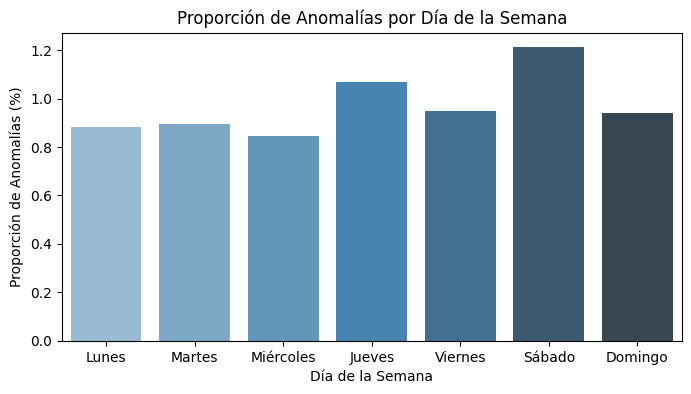

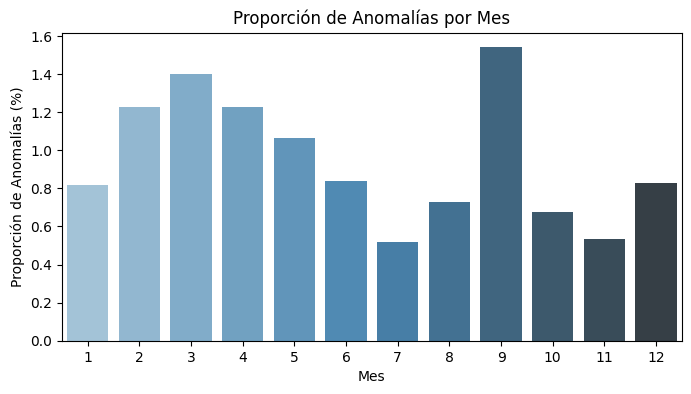

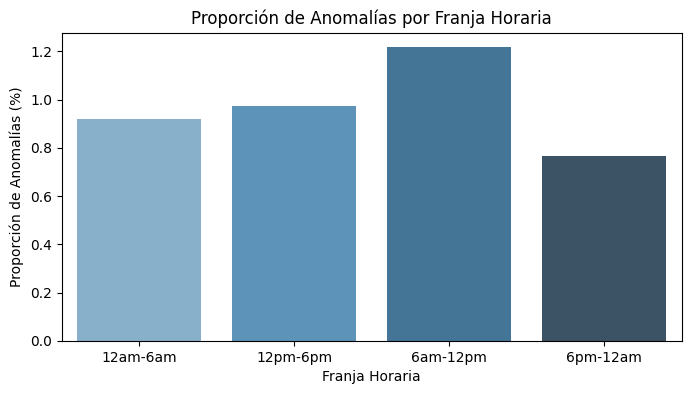


Graficas del modelo  Anomaly_R_Cov


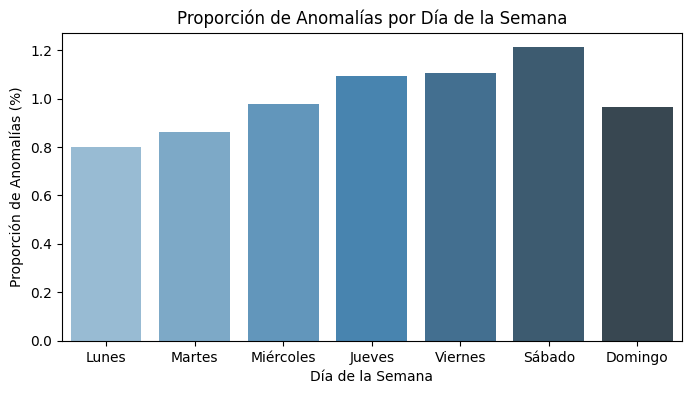

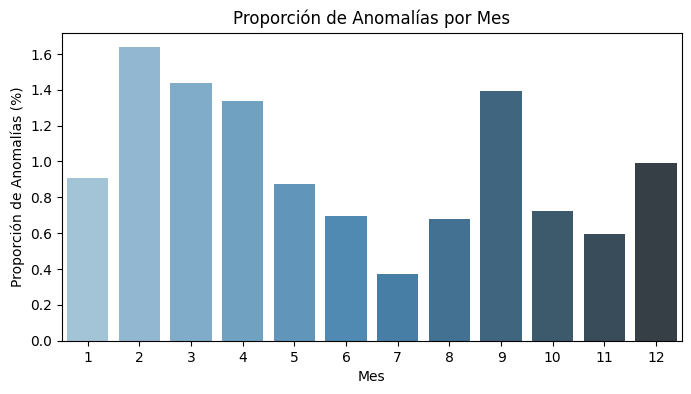

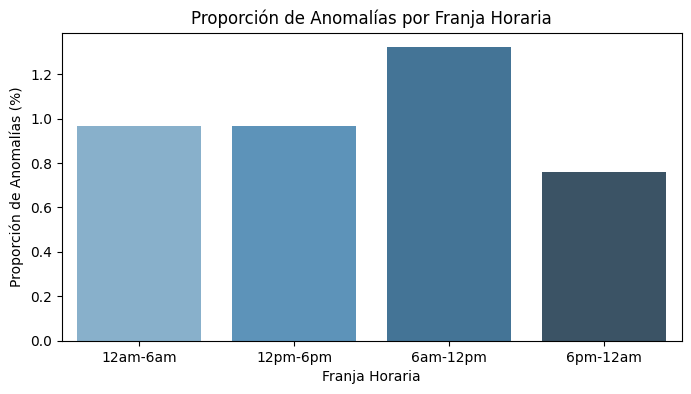


Graficas del modelo  Anomaly_LOF


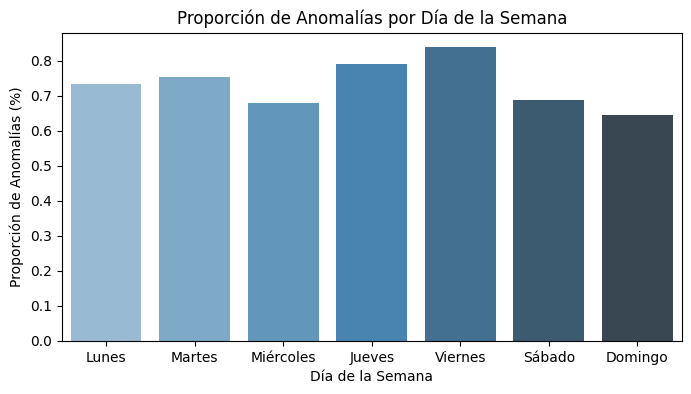

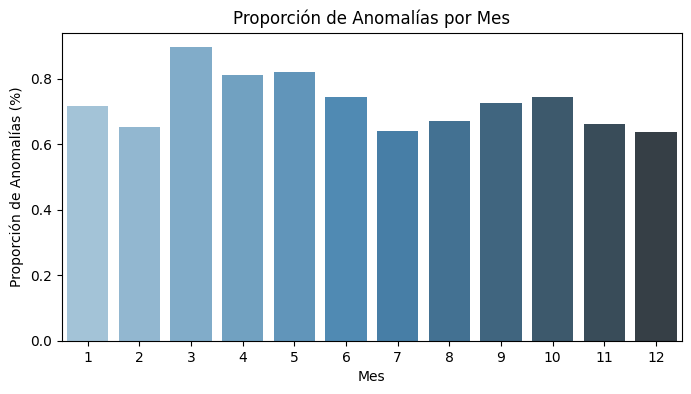

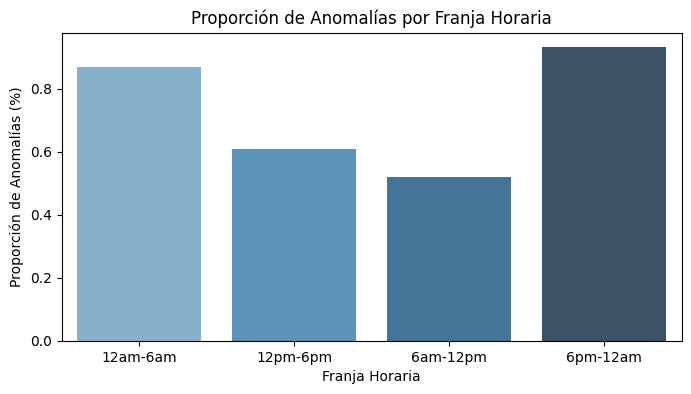


Graficas del modelo  Anomaly_PCA


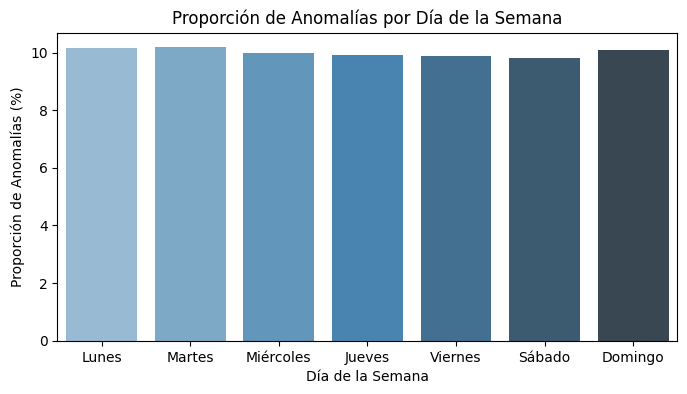

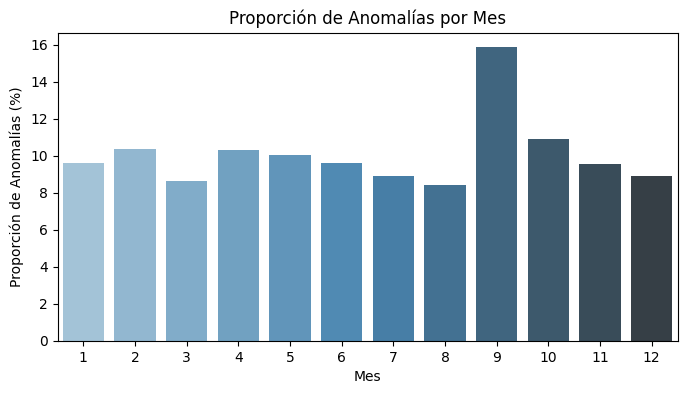

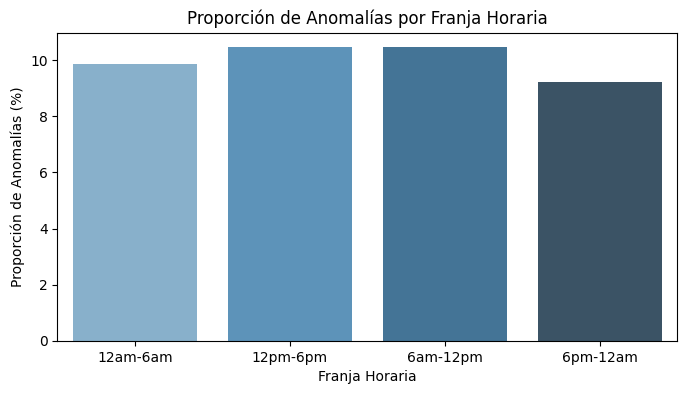


Graficas del modelo  Z_Anomaly_2.25


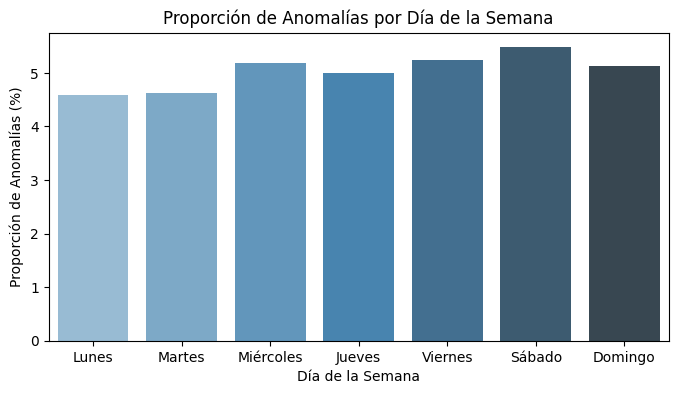

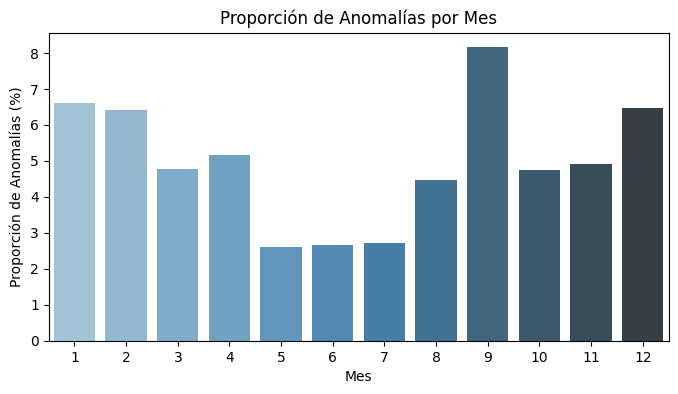

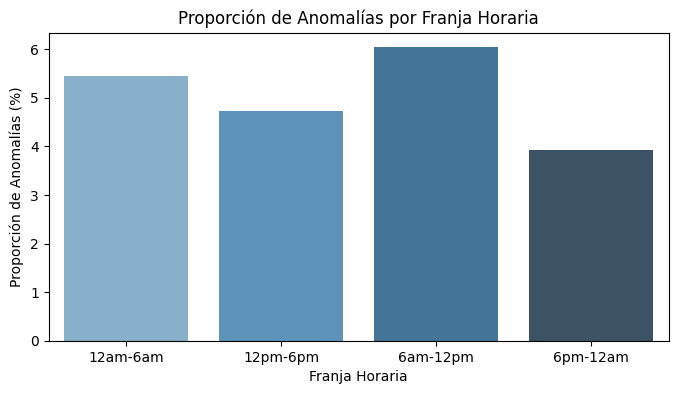


Graficas del modelo  Z_Anomaly_2.5


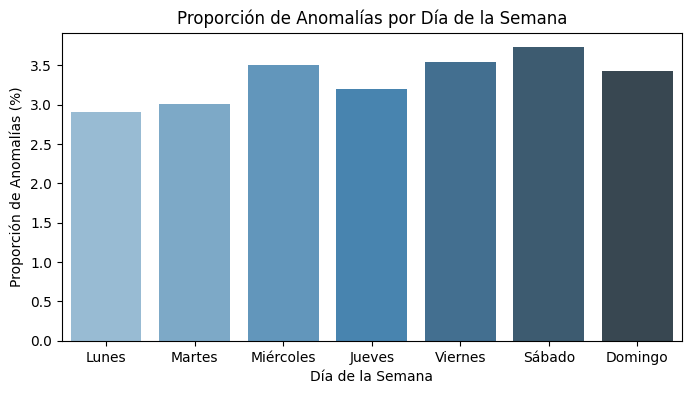

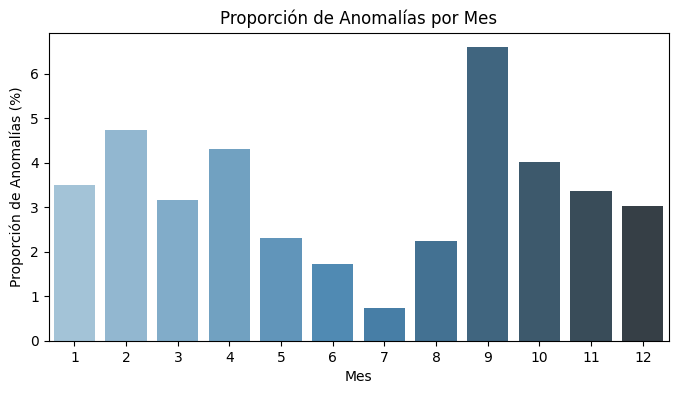

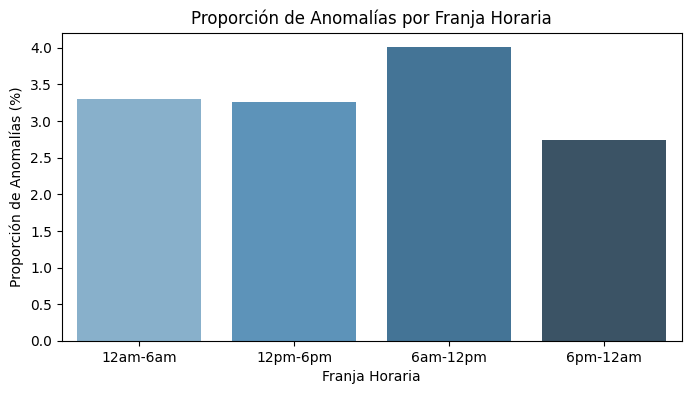


Graficas del modelo  Z_Anomaly_2.75


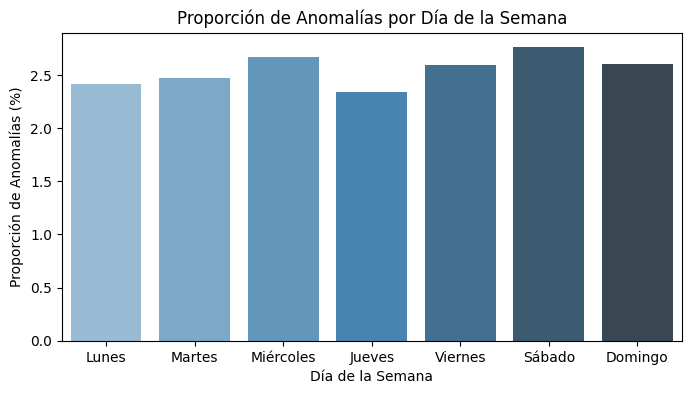

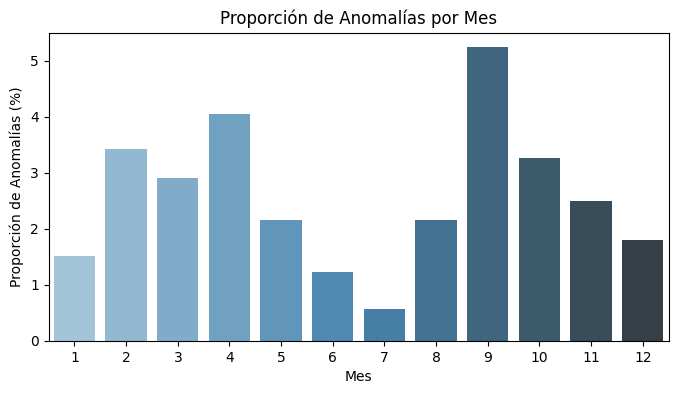

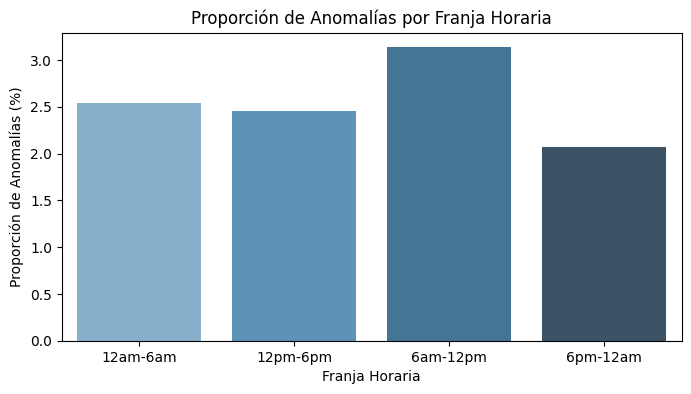


Graficas del modelo  Z_Anomaly_3


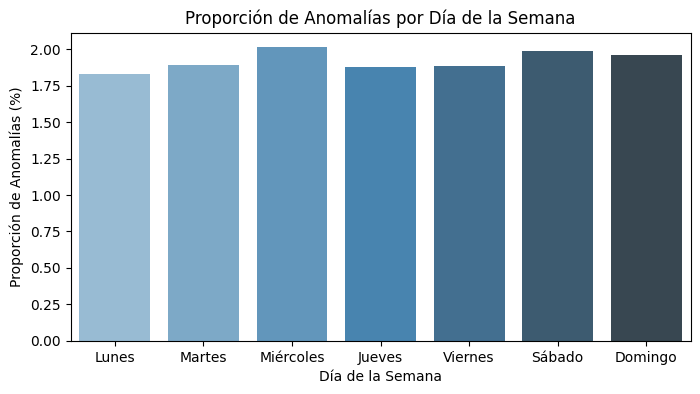

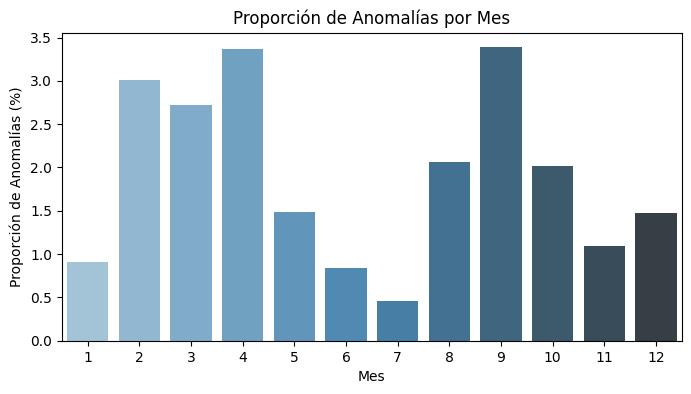

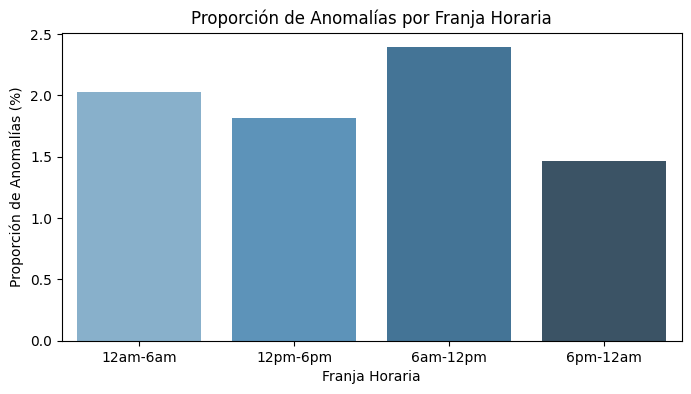

In [ ]:
columnas_graficas =[ 'Anomaly_IF', 'Anomaly_R_Cov', 'Anomaly_LOF', 'Anomaly_PCA', 'Z_Anomaly_2.25', 'Z_Anomaly_2.5', 'Z_Anomaly_2.75','Z_Anomaly_3']

# generar_graficos(merged_df_anomaly_hora,anomalia='Anomaly_IF' )

for i in columnas_graficas:
  generar_graficos(merged_df_anomaly_hora,anomalia=i)


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Anomaly_IF']).size()
print(anomaly_counts)

Anomalía  Anomaly_IF
0         0             332333
          1                538
1         0              14782
          1               2862
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Anomaly_R_Cov']).size()
print(anomaly_counts)

Anomalía  Anomaly_R_Cov
0         0                332859
          1                    12
1         0                 14140
          1                  3504
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Anomaly_LOF']).size()
print(anomaly_counts)

Anomalía  Anomaly_LOF
0         0              330467
          1                2404
1         0               17482
          1                 162
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Anomaly_PCA']).size()
print(anomaly_counts)

Anomalía  Anomaly_PCA
0         0              301285
          1               31586
1         0               14167
          1                3477
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Z_Anomaly_2.25']).size()
print(anomaly_counts)

Anomalía  Z_Anomaly_2.25
0         0                 332871
1         1                  17644
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Z_Anomaly_2.5']).size()
print(anomaly_counts)

Anomalía  Z_Anomaly_2.5
0         0                332871
1         0                  5975
          1                 11669
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Z_Anomaly_2.75']).size()
print(anomaly_counts)

Anomalía  Z_Anomaly_2.75
0         0                 332871
1         0                   8707
          1                   8937
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_hora.groupby(['Anomalía','Z_Anomaly_3']).size()
print(anomaly_counts)

Anomalía  Z_Anomaly_3
0         0              332871
1         0               10906
          1                6738
dtype: int64


In [ ]:
merged_df_anomaly_hora.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0,0,0,0,0,0,0,0
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0,0,0,0,0,0,0,0
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0,0,0,0,0,0,0,0


In [ ]:
def detect_anomalies_criticidad(client_id, data):

  client_data = data[data['Cliente_ID'] == client_id].copy()
  client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

  # Calcular la mediana y la desviación estándar
  median = client_data['Active_energy'].median()
  std_dev = client_data['Active_energy'].std()

  client_data['Z_Score'] = 0
  # Calcular los Z-scores basados en la mediana y la desviación estándar
  client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev

  # Determinar la criticidad basada en los Z-scores
  client_data['criticidad'] = pd.cut(client_data['Z_Score'],
                                      bins=[-np.inf, -2.75, -2.5, -2.25, 2.25, 2.5, 2.75, np.inf],
                                       labels=['crítica', 'moderada', 'baja', 'normal', 'baja', 'moderada', 'crítica'],
                                       right=False,
                                       ordered=False)  # Excluye el límite superior de cada bin

  client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])

  return client_data

# Procesar los datos de todos los clientes
all_z_criticidad = []
for client_id in merged_df_anomaly_hora['Cliente_ID'].unique():
    z_results = detect_anomalies_criticidad(client_id, merged_df_anomaly_hora)
    all_z_criticidad.append(z_results)

# Combinar los resultados en un DataFrame
all_z_criticidad_h = pd.concat(all_z_criticidad)
all_z_criticidad_h.head(3)

,Fecha,Cliente_ID,Sector Económico:,Mes,Dia_de_Semana,Franja_Horaria,Active_energy,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3,Z_Score,criticidad
0,2021-01-01 00:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.357841,0,0,0,0,0,0,0,0,0,-0.784317,normal
1,2021-01-01 01:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,0.372264,0,0,0,0,0,0,0,0,0,-0.774365,normal
2,2021-01-01 02:00:00,1,Elaboración de cacao y chocolate y de producto...,1,4,12am-6am,1.044687,0,0,0,0,0,0,0,0,0,-0.310384,normal


------------------------------------------------------------------------------------------------------

In [ ]:
# all_z_criticidad_h['nueva_criticidad'] = np.where((all_z_criticidad_h['Anomalía'] > 0) & (all_z_criticidad_h['criticidad'] == 'normal'), 'baja', all_z_criticidad_h['criticidad'])
# all_z_criticidad_h.head(3)

In [ ]:
all_z_criticidad_h['criticidad'].value_counts()

criticidad
normal      332871
crítica       8937
baja          5975
moderada      2732
Name: count, dtype: int64

In [ ]:
# all_z_criticidad_h['nueva_criticidad'].value_counts()

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

def graficar_energia_por_cliente_y_anomalia(dataframe):
    df = dataframe.copy()
    # Identificar los clientes únicos
    clientes = df['Cliente_ID'].unique()

    # Identificar las columnas de anomalías
    columnas_anomalias = ['Anomaly_IF', 'Anomaly_R_Cov', 'Anomaly_LOF', 'Anomaly_PCA',
                          'Z_Anomaly_2.25', 'Z_Anomaly_2.5', 'Z_Anomaly_2.75', 'Z_Anomaly_3', 'Anomalía']

    # Definir colores para cada nivel de criticidad
    colores_criticidad = {
        'crítica': 'red',
        'moderada': 'orange',
        'baja': 'yellow',
        'normal': 'green'
    }

    for cliente in clientes:
        for anomalia in columnas_anomalias:
            # Filtrar datos por cliente
            data_cliente = df[df['Cliente_ID'] == cliente]
            data_cliente['Fecha'] = pd.to_datetime(data_cliente['Fecha'])

            # Crear el gráfico
            plt.figure(figsize=(10, 6))

            # Graficar la energía activa
            plt.plot(data_cliente['Fecha'], data_cliente['Active_energy'], color='tab:blue', label='Energía Activa')

            # Filtrar y graficar las anomalías
            if anomalia == 'Anomalía':  # Aplicar colores de criticidad solo para Anomaly_Total
                for criticidad, color in colores_criticidad.items():
                    anomalias_cliente = data_cliente[(data_cliente[anomalia] > 0) & (data_cliente['criticidad'] == criticidad)]
                    if not anomalias_cliente.empty:
                        plt.scatter(anomalias_cliente['Fecha'], anomalias_cliente['Active_energy'], color=color, s=25, label=f'Nivel {criticidad}')
                        plt.title(f'Anomalías en la Energía Activa para el Cliente {cliente}')
            else:
                anomalias_cliente = data_cliente[data_cliente[anomalia] > 0]
                if not anomalias_cliente.empty:
                    plt.scatter(anomalias_cliente['Fecha'], anomalias_cliente['Active_energy'], color='#800080', s=25, label='Anomalía')
                    plt.title(f'Anomalías en la Energía Activa para el Cliente {cliente} - Anomalía: {anomalia}')


            plt.xlabel('Fecha')
            plt.ylabel('Energía Activa')
            plt.xticks(rotation=45)
            plt.grid(True)
            plt.legend()
            plt.show()
            print("")

In [ ]:
graficar_energia_por_cliente_y_anomalia(all_z_criticidad_h)

Output hidden; open in https://colab.research.google.com to view.

# Proceso para data  con promedios diarios de energía activa

In [ ]:
data_filtered_neg_sorted['Fecha'] = pd.to_datetime(data_filtered_neg_sorted['Fecha'])
data_filtered_neg_sorted['Fecha'] = data_filtered_neg_sorted['Fecha'].dt.date

daily_data = data_filtered_neg_sorted.groupby(['Fecha', 'Cliente_ID', 'Sector Económico:']).agg({
    'Active_energy': 'mean'
}).reset_index()

daily_data['Fecha'] = pd.to_datetime(daily_data['Fecha'])
daily_data.reset_index(drop=True, inplace=True)
daily_data.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836
1,2021-01-01,3,Elaboración de cacao y chocolate y de producto...,1.800346
2,2021-01-01,4,Elaboración de cacao y chocolate y de producto...,0.694088


In [ ]:
def detect_anomalies(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    # Mediana y desviación estandar
    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    # z Scores
    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Anomalía'] = ((client_data['Z_Score'] > 2.25) | (client_data['Z_Score'] < -2.25)).astype(int)

    return client_data

all_z_results = []

for client_id in daily_data['Cliente_ID'].unique():
    z_results = detect_anomalies(client_id, daily_data)
    all_z_results.append(z_results)

df_anomalias_d = pd.concat(all_z_results)
df_anomalias_d.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Z_Score,Anomalía
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,-0.147826,0
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,0.058431,0
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,-0.002475,0


# Modelo Isolation Forest

In [ ]:
import pandas as pd
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.ensemble import IsolationForest

def detect_anomalies_iforest_d(client_id, data):

    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    X = client_data[['Active_energy']]
    y = client_data['Anomalía']

    # Define los valores de hiperparámetros que deseas probar
    param_grid = {
        'n_estimators': [50,100,150,200],  # Puedes ajustar estos valores según tu necesidad
        'contamination': [0.01, 0.03, 0.04, 0.06, 0.08, 0.1, 0.15]  # Puedes ajustar estos valores según tu necesidad
    }

    # Inicializa el modelo Isolation Forest
    model = IsolationForest()

    # Realiza una búsqueda en la grilla (grid search) sobre los hiperparámetros
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='accuracy', cv=5)
    grid_search.fit(X, y)

    # Muestra los mejores hiperparámetros encontrados
    print("Mejores hiperparámetros encontrados:")
    print(grid_search.best_params_)
    print(client_id)


    # Entrena el modelo final con los mejores hiperparámetros encontrados y todos los datos disponibles
    best_model = IsolationForest(**grid_search.best_params_, random_state=123)

    anomalies = best_model.fit_predict(client_data[['Active_energy']])
    # Convertir anomalias labels  -1/1 to 0/1 (0 for normal, 1 for anomaly)
    client_data['Anomaly_IF'] = (anomalies == -1).astype(int)
    client_data['Anomaly_Score_IF'] = best_model.decision_function(client_data[['Active_energy']])


    # client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])
    client_data['Mes'] = client_data['Fecha'].dt.month
    client_data['Dia_de_Semana'] = client_data['Fecha'].dt.dayofweek
    return client_data

# Using the correct DataFrame, assuming 'data_filtered_neg_sorted'
unique_clients = df_anomalias_d['Cliente_ID'].unique()
all_results = []

for client_id in unique_clients:
    client_results = detect_anomalies_iforest_d(client_id, df_anomalias_d)
    all_results.append(client_results)

# Concatenar
final_df_diaria = pd.concat(all_results)
final_df_diaria = final_df_diaria[['Fecha', 'Cliente_ID', 'Sector Económico:', 'Active_energy','Dia_de_Semana', 'Mes', 'Anomaly_IF', 'Anomaly_Score_IF']]
final_df_diaria.head(3)

Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
1
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
3
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
4
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 150}
5
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 150}
10
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 100}
12
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
13
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
14
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
15
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 100}
16
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators': 50}
17
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_estimators':

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079


In [ ]:
final_df_diaria['Fecha'] = pd.to_datetime(final_df_diaria['Fecha'])
df_anomalias_d['Fecha'] = pd.to_datetime(df_anomalias_d['Fecha'])

merged_df_dia = pd.merge(final_df_diaria, df_anomalias_d[['Cliente_ID', 'Fecha', 'Anomalía']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0


# Modelo Robust Covariance

In [ ]:
def detect_anomalies_robust_covariance_d(client_id, data):

    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    X = client_data[['Active_energy']]
    y = client_data['Anomalía']

    # Define los valores de hiperparámetros que deseas probar
    param_grid = {
        'assume_centered': [True, False],  # Puedes ajustar estos valores según tu necesidad
        'support_fraction': [0.1,0.3,0.5, 0,8],  # Puedes ajustar estos valores según tu necesidad
        'contamination': [0.01, 0.02, 0.05, 0.08, 0.12]  # Puedes ajustar estos valores según tu necesidad
    }

    # Inicializa el modelo Isolation Forest
    model = EllipticEnvelope()

    # Realiza una búsqueda en la grilla (grid search) sobre los hiperparámetros
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='accuracy', cv=5)
    grid_search.fit(X, y)

    # Muestra los mejores hiperparámetros encontrados
    print("Mejores hiperparámetros encontrados:")
    print(grid_search.best_params_)
    print(client_id)


    # Entrena el modelo final con los mejores hiperparámetros encontrados y todos los datos disponibles
    best_model = EllipticEnvelope(**grid_search.best_params_, random_state=123)

    anomalies = best_model.fit(client_data[['Active_energy']])

    client_data['Anomaly_R_Cov'] = anomalies.predict(client_data[['Active_energy']])
    client_data['Anomaly_R_Cov'] = (client_data['Anomaly_R_Cov'] == -1).astype(int)

    # Mahalanobis distance as an anomaly score
    client_data['Anomaly_Score_R_Cov'] = anomalies.mahalanobis(client_data[['Active_energy']])

    # Normalize scores by the max score to help with interpretability
    max_distance = np.max(client_data['Anomaly_Score_R_Cov'])
    client_data['Anomaly_Score_R_Cov'] /= max_distance

    return client_data


all_robust_results = []

for client_id in df_anomalias_d['Cliente_ID'].unique():
    robust_results = detect_anomalies_robust_covariance_d(client_id, df_anomalias_d)
    all_robust_results.append(robust_results)

robust_df_dia = pd.concat(all_robust_results)
robust_df_dia.head(3)

Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
1
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
3
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
4
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
5
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
10
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.3}
12
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
13
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'support_fraction': 0.1}
14
Mejores hiperparámetros encontrados:
{'assume_centered': True, 'contamination': 0.01, 'suppo

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Z_Score,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,-0.147826,0,0,0.045391
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,0.058431,0,0,0.069092
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,-0.002475,0,0,0.061577


In [ ]:
# Ensure the date formats and data types are consistent
merged_df_dia['Fecha'] = pd.to_datetime(merged_df_dia['Fecha'])
robust_df_dia['Fecha'] = pd.to_datetime(robust_df_dia['Fecha'])


merged_df_dia = pd.merge(merged_df_dia, robust_df_dia[['Cliente_ID', 'Fecha', 'Anomaly_R_Cov', 'Anomaly_Score_R_Cov']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577


# Modelo Local Outlier Factor

In [ ]:
def detect_anomalies_lof_d(client_id, data):

  client_data = data[data['Cliente_ID'] == client_id].copy()
  client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

  X = client_data[['Active_energy']]
  y = client_data['Anomalía']

  # Define los valores de hiperparámetros que deseas probar
  param_grid = {
    'n_neighbors': [5, 10, 15, 300],  # Número de vecinos
    'contamination': [0.01,0.025,0.035,0.05, 0.1],  # Proporción de valores atípicos esperados
    'novelty':[True, False]
  }

  # Inicializa el modelo Isolation Forest
  model = LocalOutlierFactor()

  # Realiza una búsqueda en la grilla (grid search) sobre los hiperparámetros
  grid_search = GridSearchCV(estimator=model, param_grid=param_grid, scoring='accuracy', cv=5)
  grid_search.fit(X, y)

  # Muestra los mejores hiperparámetros encontrados
  print("Mejores hiperparámetros encontrados:")
  print(grid_search.best_params_)
  print(client_id)


  # Entrena el modelo final con los mejores hiperparámetros encontrados y todos los datos disponibles
  best_model = LocalOutlierFactor(**grid_search.best_params_)

  anomalies = best_model.fit(client_data[['Active_energy']])

  client_data['Anomaly_LOF'] = anomalies.predict(client_data[['Active_energy']])
  client_data['Anomaly_LOF'] = (client_data['Anomaly_LOF'] == -1).astype(int)  # Convert -1 to 1 for anomalies, 1 to 0 for normal


  # Negative outlier factor as score
  client_data['Anomaly_Score_LOF'] = -anomalies.decision_function(client_data[['Active_energy']])  # Making it positive for easier interpretation

  return client_data


all_lof_results = []

for client_id in df_anomalias_d['Cliente_ID'].unique():
    lof_results = detect_anomalies_lof_d(client_id, df_anomalias_d)
    all_lof_results.append(lof_results)

lof_df_dia = pd.concat(all_lof_results)
lof_df_dia.head(3)

Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
1
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
3
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
4
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
5
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 10, 'novelty': True}
10
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 10, 'novelty': True}
12
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
13
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
14
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 5, 'novelty': True}
15
Mejores hiperparámetros encontrados:
{'contamination': 0.01, 'n_neighbors': 15, 'novelty': True}
16
Mejores hip

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Z_Score,Anomalía,Anomaly_LOF,Anomaly_Score_LOF
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,-0.147826,0,0,-1.661706
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,0.058431,0,0,-1.680689
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,-0.002475,0,0,-1.484024


In [ ]:
merged_df_dia['Fecha'] = pd.to_datetime(merged_df_dia['Fecha'])
lof_df_dia['Fecha'] = pd.to_datetime(lof_df_dia['Fecha'])

merged_df_dia = pd.merge(merged_df_dia, lof_df_dia[['Cliente_ID', 'Fecha', 'Anomaly_LOF', 'Anomaly_Score_LOF']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391,0,-1.661706
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092,0,-1.680689
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577,0,-1.484024


# Modelo PCA

In [ ]:
def reconstruccion_pca_para_clientes_d(data_filtered_neg, n_components):
    '''
    Función para reconstruir los datos de todos los clientes utilizando PCA.

    Parameters
    ----------
    data_filtered_neg : pandas.DataFrame
        DataFrame que contiene los datos de los clientes.
    n_components : int
        Número de componentes principales a retener en PCA.

    Returns
    -------
    resultados : pandas.DataFrame
        DataFrame con los resultados de la reconstrucción y la detección de anomalías
        para todos los clientes.
    '''

    resultados = pd.DataFrame()

    # Iterar sobre cada cliente
    for num_cliente in data_filtered_neg['Cliente_ID'].unique():
        # Filtrar datos del cliente actual
        df = data_filtered_neg[data_filtered_neg['Cliente_ID'] == num_cliente]

        df = df[['Cliente_ID', 'Fecha', 'Active_energy', 'Reactive_energy', 'Voltaje_FA', 'Voltaje_FC']]


        # Convertir la columna 'Fecha' a tipo datetime
        df['Fecha'] = pd.to_datetime(df['Fecha'])
        # Establecer la columna 'Fecha' como índice del DataFrame
        df.set_index('Fecha', inplace=True)
        # Agrupar los datos por día y calcular la media móvil y desviación estándar móvil
        df = df.resample('D').mean()
        df.reset_index(inplace=True)

        reconstruccion, error_reconstruccion = reconstruccion_pca(X=df.drop(columns=['Cliente_ID', 'Fecha']), n_components=n_components)

        # Calcular el cuantil 0.9 del error de reconstrucción
        cuantil = np.quantile(a=error_reconstruccion, q=0.9)

        # Crear una nueva columna 'anomalía' y asignar 1 si es una anomalía y 0 si no lo es
        df['Anomaly_PCA'] = np.where(error_reconstruccion >= cuantil, 1, 0)
        df['Anomaly_Score_PCA'] = error_reconstruccion

        # Agregar resultados al DataFrame principal
        resultados = pd.concat([resultados, df])

    return resultados

pca_df_d= reconstruccion_pca_para_clientes_d(data_filtered_neg_sorted, n_components=2)
pca_df_d.head(3)

Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucción con un PCA de 2 componentes
Reconstrucc

,Fecha,Cliente_ID,Active_energy,Reactive_energy,Voltaje_FA,Voltaje_FC,Anomaly_PCA,Anomaly_Score_PCA
0,2021-01-01,1.0,1.248836,0.634709,484.340350,484.910728,0,0.149657
1,2021-01-02,1.0,1.540760,0.758123,508.673472,497.360742,0,21.173376
2,2021-01-03,1.0,1.454557,0.781249,501.406658,536.713609,0,139.004693


In [ ]:
merged_df_dia['Fecha'] = pd.to_datetime(merged_df_dia['Fecha'])

pca_df_d['Cliente_ID'] = pca_df_d['Cliente_ID'].astype('Int64')
pca_df_d['Fecha'] = pd.to_datetime(pca_df_d['Fecha'])

merged_df_dia = pd.merge(merged_df_dia, pca_df_d[['Cliente_ID', 'Fecha', 'Anomaly_PCA', 'Anomaly_Score_PCA']],
                     on=['Cliente_ID', 'Fecha'], how='left')

merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391,0,-1.661706,0,0.149657
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092,0,-1.680689,0,21.173376
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577,0,-1.484024,0,139.004693


# Modelo Z- Score

In [ ]:
def detect_anomalies_z_score_d_2_25(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    # Calculate the median and standard deviation
    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    # Calculate Z-scores based on the median and standard deviation
    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_2.25'] = ((client_data['Z_Score'] > 2.25) | (client_data['Z_Score'] < -2.25)).astype(int)

    client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])

    return client_data

all_z_results = []

for client_id in df_anomalias_d['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_d_2_25(client_id, df_anomalias_d)
    all_z_results.append(z_results)

z_df_d_2_25 = pd.concat(all_z_results)
z_df_d_2_25.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Z_Score,Anomalía,Z_Anomaly_2.25
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,-0.147826,0,0
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,0.058431,0,0
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,-0.002475,0,0


In [ ]:
z_df_d_2_25['Fecha'] = pd.to_datetime(z_df_d_2_25['Fecha'])

merged_df_dia = pd.merge(merged_df_dia, z_df_d_2_25[['Cliente_ID', 'Fecha', 'Z_Anomaly_2.25']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391,0,-1.661706,0,0.149657,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092,0,-1.680689,0,21.173376,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577,0,-1.484024,0,139.004693,0


In [ ]:
def detect_anomalies_z_score_d_2_5(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()


    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_2.5'] = ((client_data['Z_Score'] > 2.5) | (client_data['Z_Score'] < -2.5)).astype(int)

    client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])
    return client_data


all_z_results_1 = []

for client_id in daily_data['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_d_2_5(client_id, daily_data)
    all_z_results_1.append(z_results)

z_df_d_2_5 = pd.concat(all_z_results_1)
z_df_d_2_5.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Z_Score,Z_Anomaly_2.5
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,-0.147826,0
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,0.058431,0
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,-0.002475,0


In [ ]:
# Ensure the 'Fecha' column is in datetime format for accurate merging
z_df_d_2_5['Fecha'] = pd.to_datetime(z_df_d_2_5['Fecha'])

# Merge Z-score results
merged_df_dia = pd.merge(merged_df_dia, z_df_d_2_5[['Cliente_ID', 'Fecha', 'Z_Anomaly_2.5']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391,0,-1.661706,0,0.149657,0,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092,0,-1.680689,0,21.173376,0,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577,0,-1.484024,0,139.004693,0,0


In [ ]:
def detect_anomalies_z_score_d_2_75(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)


    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_2.75'] = ((client_data['Z_Score'] > 2.75) | (client_data['Z_Score'] < -2.75)).astype(int)

    client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])

    return client_data


all_z_results_2 = []

for client_id in daily_data['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_d_2_75(client_id, daily_data)
    all_z_results_2.append(z_results)

z_df_d_2_75 = pd.concat(all_z_results_2)
z_df_d_2_75.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Z_Score,Z_Anomaly_2.75
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,-0.147826,0
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,0.058431,0
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,-0.002475,0


In [ ]:
z_df_d_2_75['Fecha'] = pd.to_datetime(z_df_d_2_75['Fecha'])


merged_df_dia = pd.merge(merged_df_dia, z_df_d_2_75[['Cliente_ID', 'Fecha', 'Z_Anomaly_2.75']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391,0,-1.661706,0,0.149657,0,0,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092,0,-1.680689,0,21.173376,0,0,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577,0,-1.484024,0,139.004693,0,0,0


In [ ]:
def detect_anomalies_z_score_d_3(client_id, data):
    client_data = data[data['Cliente_ID'] == client_id].copy()
    client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)


    median = client_data['Active_energy'].median()
    std_dev = client_data['Active_energy'].std()

    client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev
    client_data['Z_Anomaly_3'] = ((client_data['Z_Score'] > 3) | (client_data['Z_Score'] < -3)).astype(int)

    client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])
    return client_data


all_z_results_3 = []

for client_id in daily_data['Cliente_ID'].unique():
    z_results = detect_anomalies_z_score_d_3(client_id, daily_data)
    all_z_results_3.append(z_results)

z_df_d_3 = pd.concat(all_z_results_3)
z_df_d_3.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Z_Score,Z_Anomaly_3
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,-0.147826,0
24,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,0.058431,0
48,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,-0.002475,0


In [ ]:
z_df_d_3['Fecha'] = pd.to_datetime(z_df_d_3['Fecha'])

# Merge Z-score results
merged_df_dia = pd.merge(merged_df_dia, z_df_d_3[['Cliente_ID', 'Fecha', 'Z_Anomaly_3']],
                     on=['Cliente_ID', 'Fecha'], how='left')
merged_df_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391,0,-1.661706,0,0.149657,0,0,0,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092,0,-1.680689,0,21.173376,0,0,0,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577,0,-1.484024,0,139.004693,0,0,0,0


# Resultados por dia

In [ ]:
merged_df_anomaly_dia=merged_df_dia.copy()
merged_df_anomaly_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomaly_Score_IF,Anomalía,Anomaly_R_Cov,Anomaly_Score_R_Cov,Anomaly_LOF,Anomaly_Score_LOF,Anomaly_PCA,Anomaly_Score_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0.212547,0,0,0.045391,0,-1.661706,0,0.149657,0,0,0,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0.266593,0,0,0.069092,0,-1.680689,0,21.173376,0,0,0,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0.298079,0,0,0.061577,0,-1.484024,0,139.004693,0,0,0,0


In [ ]:
merged_df_anomaly_dia = merged_df_anomaly_dia.drop(['Anomaly_Score_IF', 'Anomaly_Score_R_Cov','Anomaly_Score_LOF','Anomaly_Score_PCA'], axis=1)  # Eliminar columnas innecesarias
merged_df_anomaly_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0,0,0,0,0,0,0,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0,0,0,0,0,0,0,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0,0,0,0,0,0,0,0


Graficas del modelo  Anomaly_IF


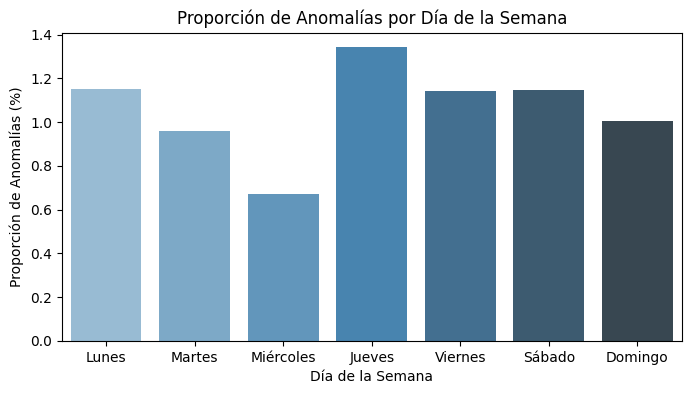

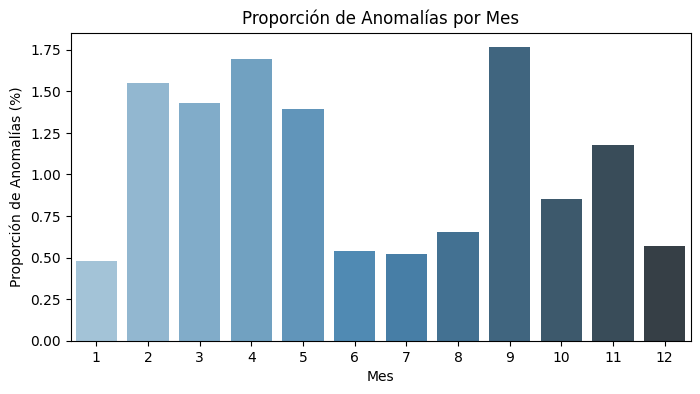


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Anomaly_R_Cov


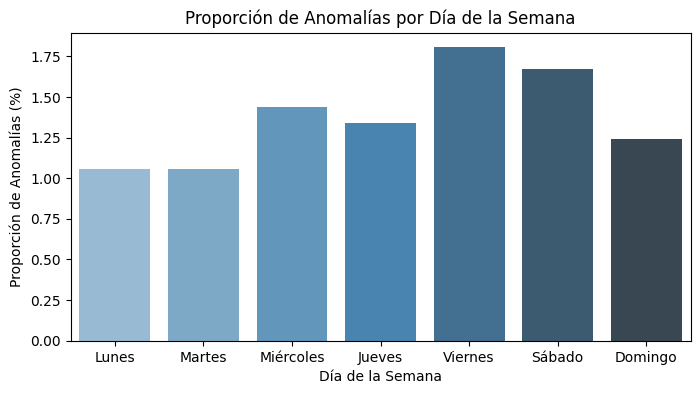

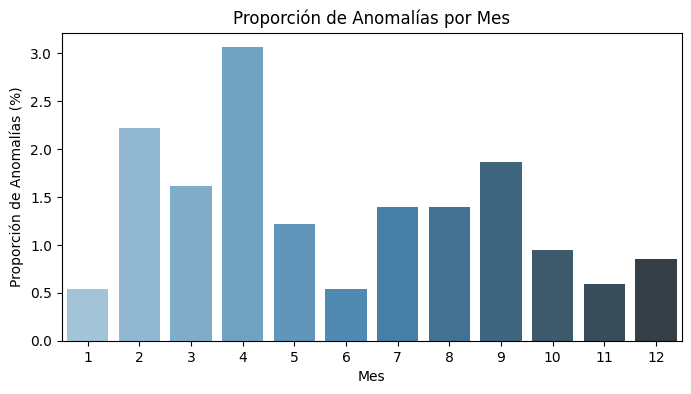


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Anomaly_LOF


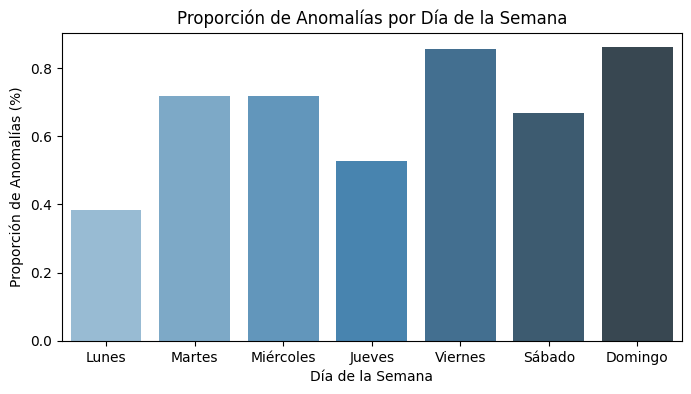

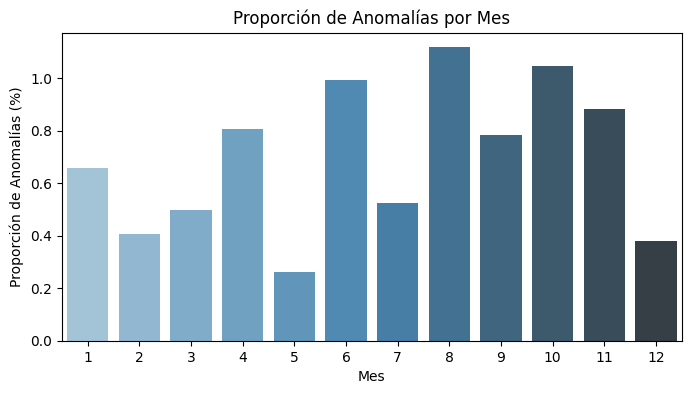


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Anomaly_PCA


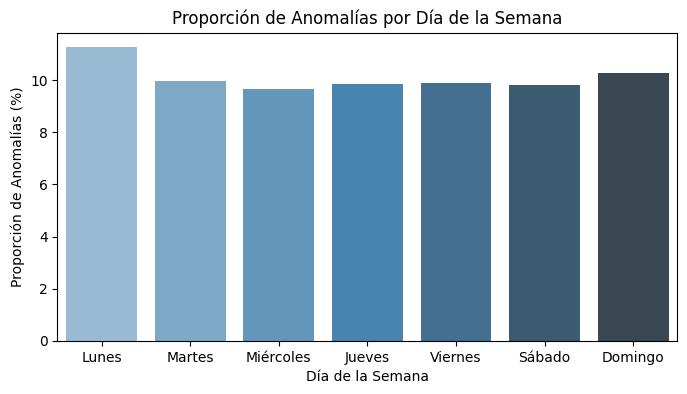

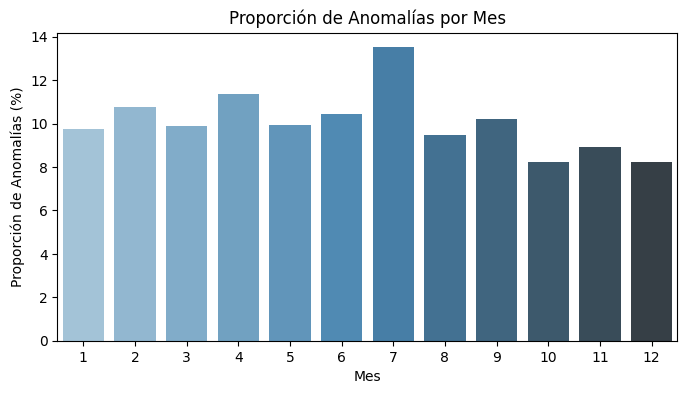


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Z_Anomaly_2.25


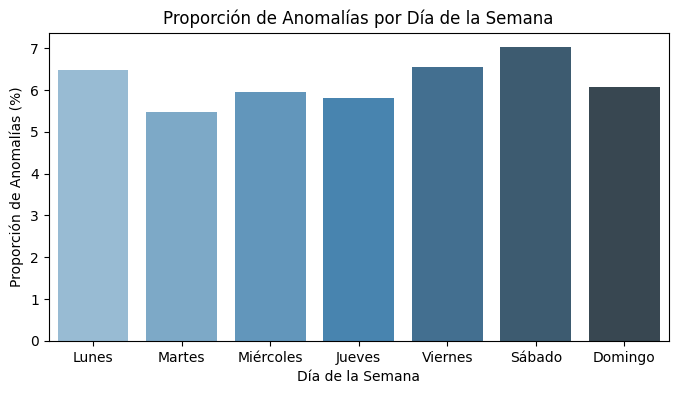

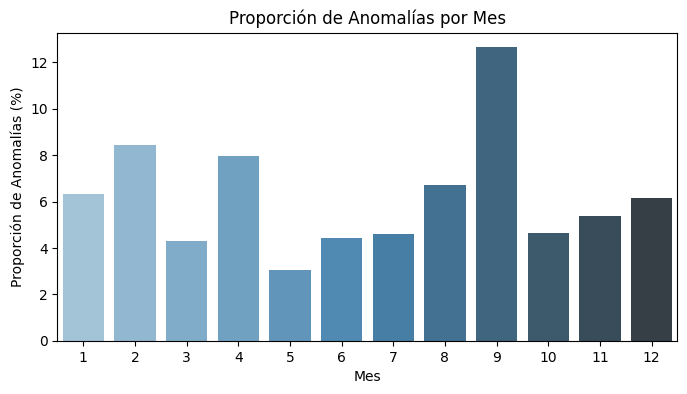


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Z_Anomaly_2.5


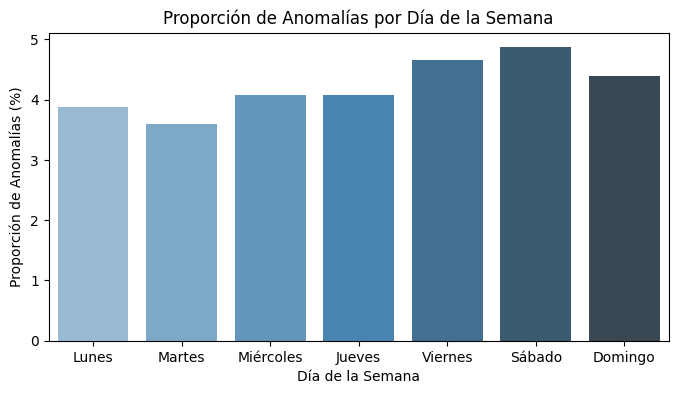

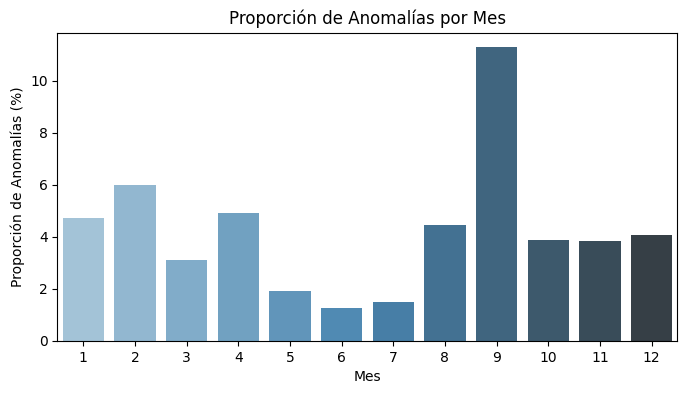


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Z_Anomaly_2.75


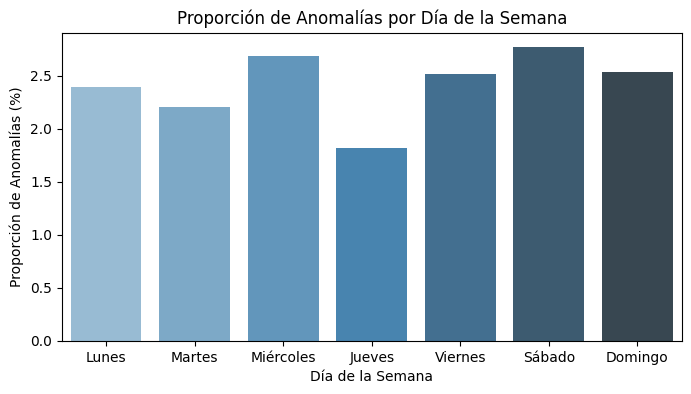

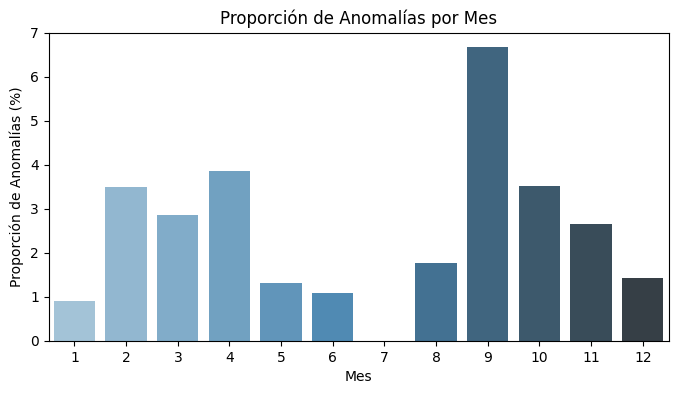


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Z_Anomaly_3


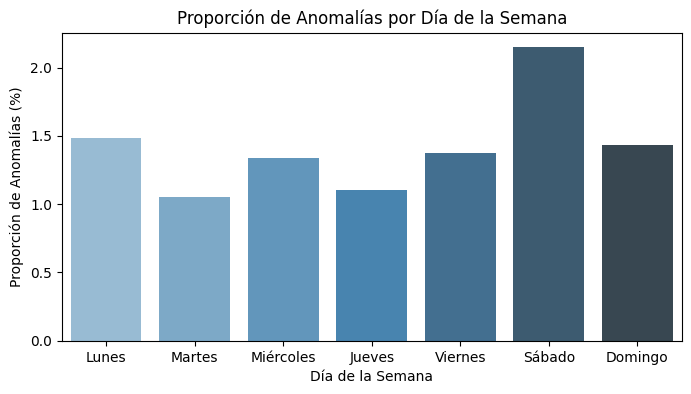

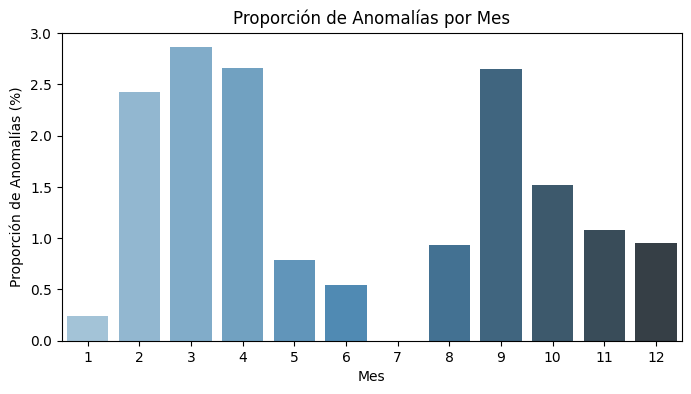


La columna 'Franja_Horaria' no existe en el DataFrame.
Graficas del modelo  Anomalía


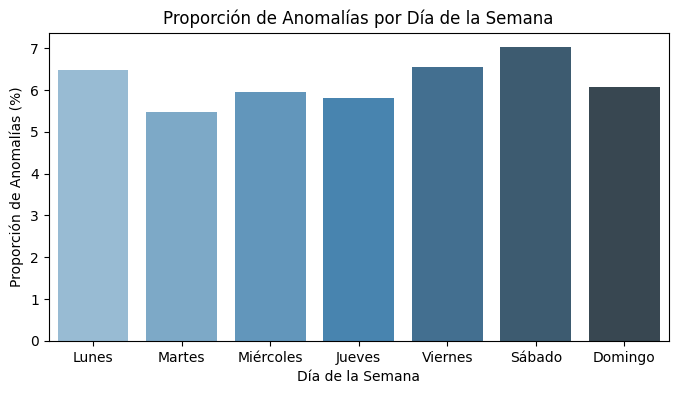

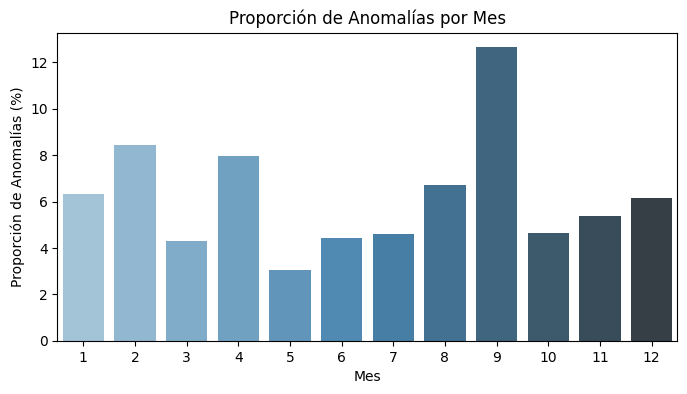


La columna 'Franja_Horaria' no existe en el DataFrame.


In [ ]:
columnas_graficas =[ 'Anomaly_IF', 'Anomaly_R_Cov', 'Anomaly_LOF',
       'Anomaly_PCA', 'Z_Anomaly_2.25', 'Z_Anomaly_2.5', 'Z_Anomaly_2.75',
       'Z_Anomaly_3', 'Anomalía']

# generar_graficos(merged_df_anomaly_dia,anomalia='Anomaly_IF' )

for i in columnas_graficas:
  generar_graficos(merged_df_anomaly_dia,anomalia=i)

In [ ]:
anomaly_counts = merged_df_anomaly_dia.groupby(['Anomalía','Anomaly_LOF']).size()

# Print the counts
print(anomaly_counts)

Anomalía  Anomaly_LOF
0         0              13641
          1                 91
1         0                898
          1                  8
dtype: int64


In [ ]:
anomaly_counts = merged_df_anomaly_dia.groupby(['Anomalía','Z_Anomaly_2.75']).size()

# Print the counts
print(anomaly_counts)

Anomalía  Z_Anomaly_2.75
0         0                 13732
1         0                   552
          1                   354
dtype: int64


In [ ]:
def detect_anomalies_criticidad(client_id, data):

  client_data = data[data['Cliente_ID'] == client_id].copy()
  client_data['Active_energy'] = client_data['Active_energy'].astype(np.float64)

  # Calcular la mediana y la desviación estándar
  median = client_data['Active_energy'].median()
  std_dev = client_data['Active_energy'].std()

  client_data['Z_Score'] = 0
  # Calcular los Z-scores basados en la mediana y la desviación estándar
  client_data['Z_Score'] = (client_data['Active_energy'] - median) / std_dev

  # Determinar la criticidad basada en los Z-scores
  client_data['criticidad'] = pd.cut(client_data['Z_Score'],
                                      bins=[-np.inf, -2.75, -2.5, -2.25, 2.25, 2.5, 2.75, np.inf],
                                       labels=['crítica', 'moderada', 'baja', 'normal', 'baja', 'moderada', 'crítica'],
                                       right=False,
                                       ordered=False)  # Excluye el límite superior de cada bin

  client_data['Fecha'] = pd.to_datetime(client_data['Fecha'])

  return client_data

# Procesar los datos de todos los clientes
all_z_criticidad = []
for client_id in daily_data['Cliente_ID'].unique():
    z_results = detect_anomalies_criticidad(client_id, merged_df_anomaly_dia)
    all_z_criticidad.append(z_results)

# Combinar los resultados en un DataFrame
all_z_criticidad = pd.concat(all_z_criticidad)
all_z_criticidad.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3,Z_Score,criticidad
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0,0,0,0,0,0,0,0,-0.147826,normal
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0,0,0,0,0,0,0,0,0.058431,normal
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0,0,0,0,0,0,0,0,-0.002475,normal


Esto pierde sentido

In [ ]:
all_z_criticidad['nueva_criticidad'] = np.where((all_z_criticidad['Anomalía'] > 0) & (all_z_criticidad['criticidad'] == 'normal'), 'baja', all_z_criticidad['criticidad'])
all_z_criticidad.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3,Z_Score,criticidad,nueva_criticidad
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0,0,0,0,0,0,0,0,-0.147826,normal,normal
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0,0,0,0,0,0,0,0,0.058431,normal,normal
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0,0,0,0,0,0,0,0,-0.002475,normal,normal


In [ ]:
all_z_criticidad['criticidad'].value_counts()

criticidad
normal      13732
crítica       354
baja          288
moderada      264
Name: count, dtype: int64

In [ ]:
all_z_criticidad['nueva_criticidad'].value_counts()

nueva_criticidad
normal      13732
crítica       354
baja          288
moderada      264
Name: count, dtype: int64

In [ ]:
all_z_criticidad.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3,Z_Score,criticidad,nueva_criticidad
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0,0,0,0,0,0,0,0,-0.147826,normal,normal
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0,0,0,0,0,0,0,0,0.058431,normal,normal
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0,0,0,0,0,0,0,0,-0.002475,normal,normal


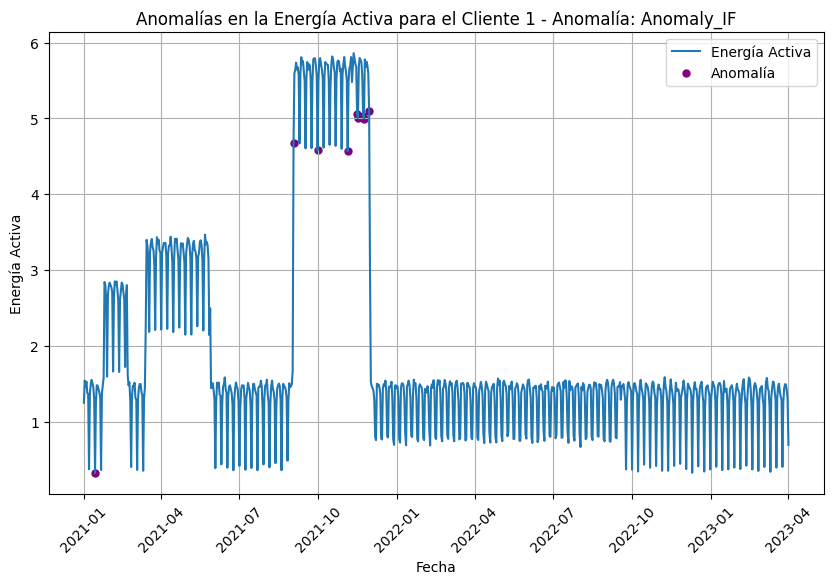

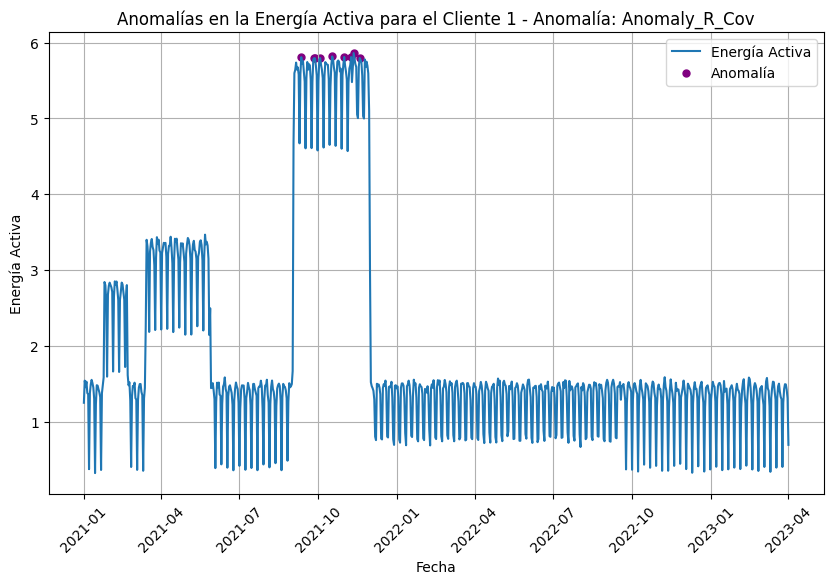

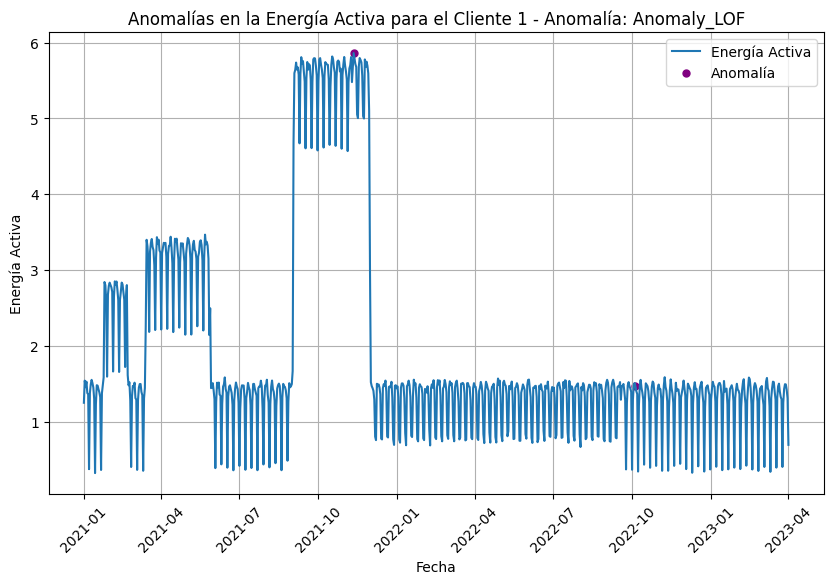

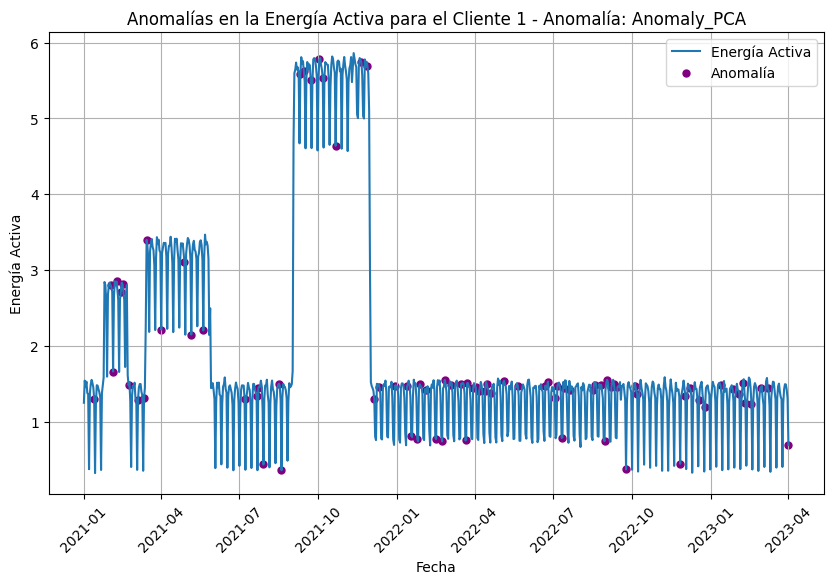

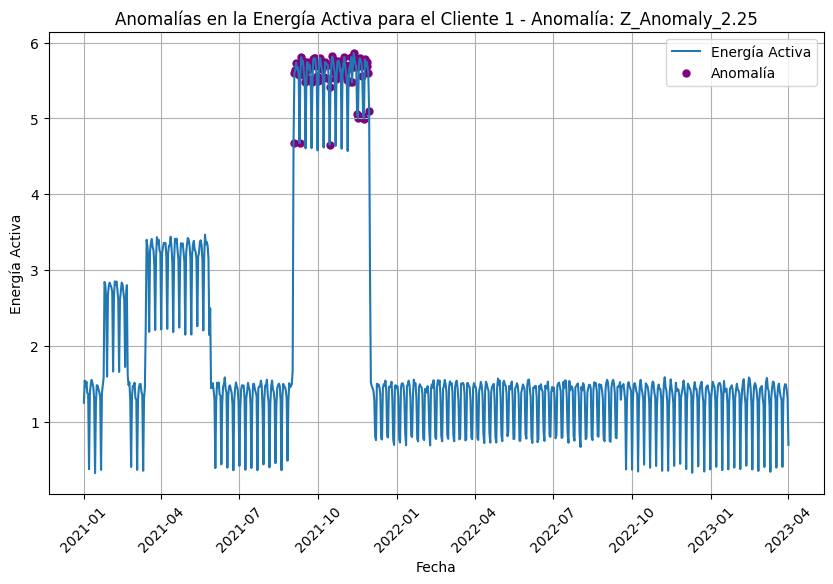

...

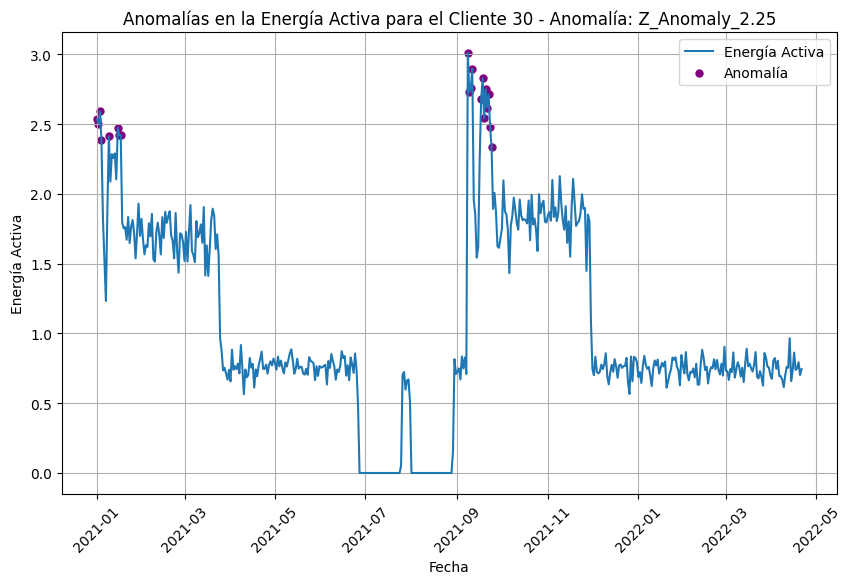

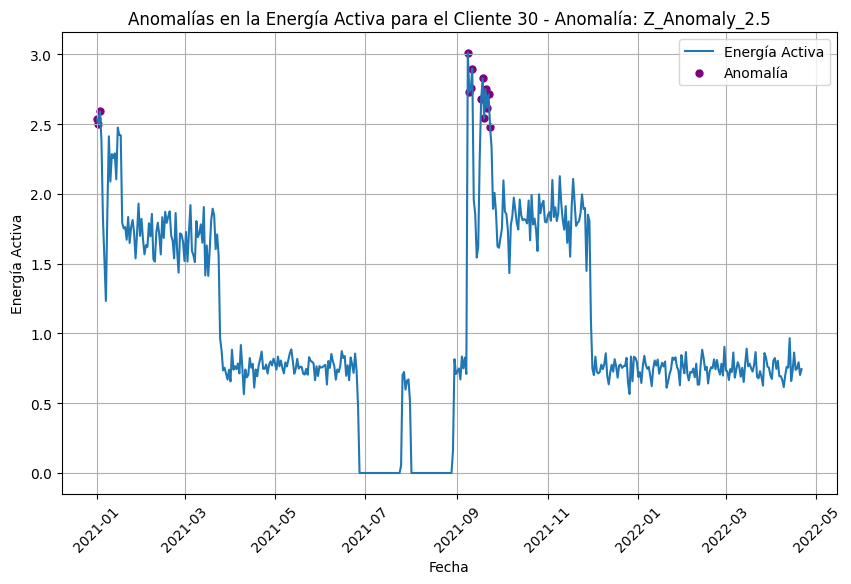

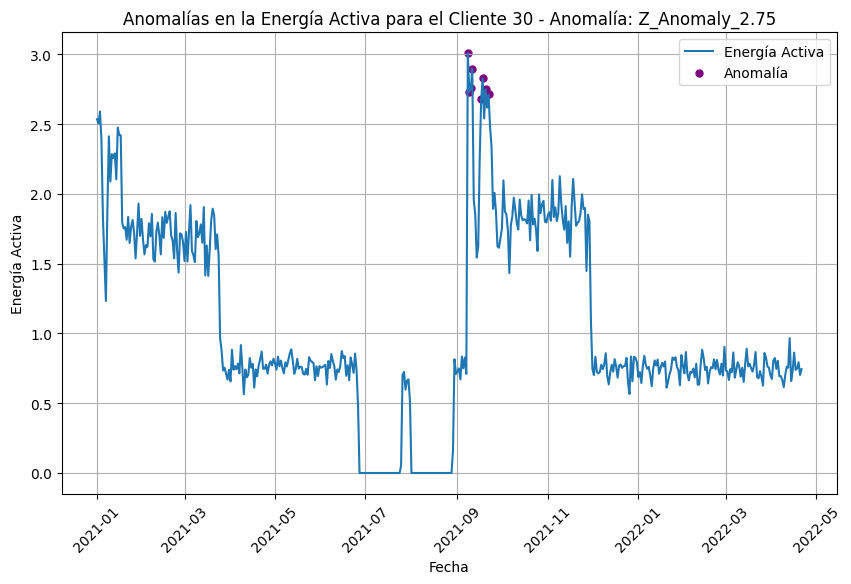

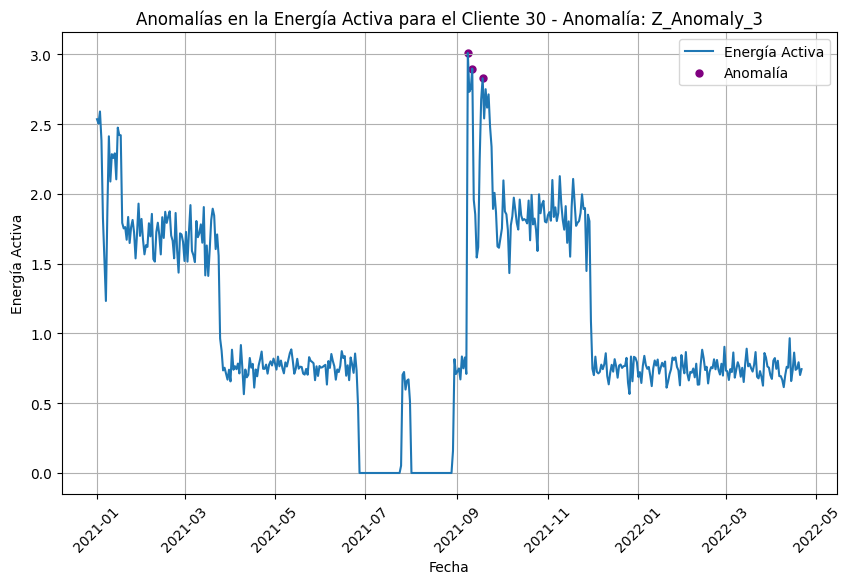

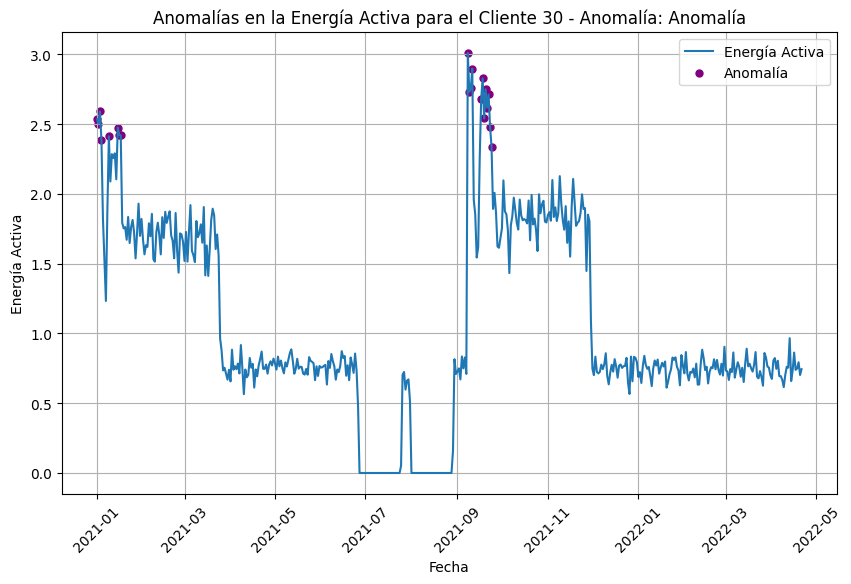

In [ ]:
graficar_energia_por_cliente_y_anomalia(all_z_criticidad)

In [ ]:
merged_df_anomaly_dia.head(3)

,Fecha,Cliente_ID,Sector Económico:,Active_energy,Dia_de_Semana,Mes,Anomaly_IF,Anomalía,Anomaly_R_Cov,Anomaly_LOF,Anomaly_PCA,Z_Anomaly_2.25,Z_Anomaly_2.5,Z_Anomaly_2.75,Z_Anomaly_3
0,2021-01-01,1,Elaboración de cacao y chocolate y de producto...,1.248836,4,1,0,0,0,0,0,0,0,0,0
1,2021-01-02,1,Elaboración de cacao y chocolate y de producto...,1.540760,5,1,0,0,0,0,0,0,0,0,0
2,2021-01-03,1,Elaboración de cacao y chocolate y de producto...,1.454557,6,1,0,0,0,0,0,0,0,0,0


## Matriz de confusión

In [ ]:
y_true_columns = ['Anomalía']
columnas_prediccion = [merged_df_anomaly_dia['Anomaly_IF'], merged_df_anomaly_dia['Anomaly_R_Cov'],
                       merged_df_anomaly_dia['Anomaly_LOF'], merged_df_anomaly_dia['Anomaly_PCA'],
                       merged_df_anomaly_dia['Z_Anomaly_2.5'],
                       merged_df_anomaly_dia['Z_Anomaly_2.75'],merged_df_anomaly_dia['Z_Anomaly_3']]


nombres_columnas = ['Anomaly_IF', 'Anomaly_R_Cov', 'Anomaly_LOF', 'Anomaly_PCA',
                    'Z_Anomaly_2.5', 'Z_Anomaly_2.75', 'Z_Anomaly_3']

for y_true_column in y_true_columns:
    y_true = merged_df_anomaly_dia[y_true_column]  # Columna real
    matrices_confusion = calcular_matrices_confusion(y_true, columnas_prediccion, nombres_columnas)

    print("\nMatrices de Confusión para", y_true_column)
    imprimir_matrices_confusion(matrices_confusion, nombres_columnas)


Matrices de Confusión para Anomalía
Nombre          |   TN   FP   FN   TP  Accuracy  Precision  Recall  Specificity  F1 Score
---------------------------------------------------------------------------------------
Anomaly_IF     | 13673    59   810    96   0.9406    0.6194    0.1060     0.9957     0.1810
Anomaly_R_Cov  | 13711    21   726   180   0.9490    0.8955    0.1987     0.9985     0.3252
Anomaly_LOF    | 13641    91   898     8   0.9324    0.0808    0.0088     0.9934     0.0159
Anomaly_PCA    | 12339  1393   819    87   0.8489    0.0588    0.0960     0.8986     0.0729
Z_Anomaly_2.5  | 13732     0   288   618   0.9803    1.0000    0.6821     1.0000     0.8110
Z_Anomaly_2.75 | 13732     0   552   354   0.9623    1.0000    0.3907     1.0000     0.5619
Z_Anomaly_3    | 13732     0   698   208   0.9523    1.0000    0.2296     1.0000     0.3734
